# Data Gathering and Data Frame


### Data Imports

In [122]:
from google.colab import files
import pandas as pd
import matplotlib.pyplot as plt
from google.colab import data_table

In [123]:
# Upload the CSV file
uploaded = files.upload()


Saving Full_Participant2SaveData.csv to Full_Participant2SaveData (1).csv


In [124]:
# Get the file name
file_name = next(iter(uploaded))

# Load the CSV file
originaldf = pd.read_csv(file_name, low_memory=False)
MainDataFrame = pd.read_csv(file_name, low_memory=False)


In [125]:
# Get the header row
header_row = MainDataFrame.iloc[0]

# Find duplicate rows
is_duplicate = MainDataFrame.duplicated(keep=False)

# Check if rows are identical to the header row
is_identical_to_header = MainDataFrame.apply(lambda row: row.equals(header_row), axis=1)

# Keep only rows that are not duplicates or identical to the header row
MainDataFrame = MainDataFrame[~is_duplicate | is_identical_to_header]


In [126]:
# Find occurrences of the value "Time"
time_occurrences = MainDataFrame[MainDataFrame.eq('Time').any(axis=1)]

# Display the occurrences
print(time_occurrences)


Empty DataFrame
Columns: [Time, frame, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize]
Index: []

[0 rows x 36 columns]


In [128]:
# Calculate the minimum value of 'ConstrictedSize'
min_constricted_size = MainDataFrame['ConstrictedSize'].min()

# Calculate the maximum value of 'DilatedSize'
max_dilated_size = MainDataFrame['DilatedSize'].max()

print("Minimum ConstrictedSize:", min_constricted_size)
print("Maximum DilatedSize:", max_dilated_size)

Minimum ConstrictedSize: 1.457352
Maximum DilatedSize: 5.053528


### Data Table

In [129]:
import numpy as np

# Convert the 'RightPupilSize' column to numeric, replacing non-numeric values with NaN
MainDataFrame['LeftPupilSize'] = pd.to_numeric(MainDataFrame['LeftPupilSize'], errors='coerce')

# Filter rows where 'RightPupilSize' is NaN
rows_with_non_numeric = MainDataFrame[np.isnan(MainDataFrame['LeftPupilSize'])]
print(rows_with_non_numeric)


Empty DataFrame
Columns: [Time, frame, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize]
Index: []

[0 rows x 36 columns]


In [130]:
# Calculate the average of LeftPupilSize and RightPupilSize (ignoring -1 values) with 6 decimal places
MainDataFrame['AveragePupilSize'] = MainDataFrame[['LeftPupilSize', 'RightPupilSize']].apply(
    lambda row: round(row.mean(), 6) if row['LeftPupilSize'] != -1 and row['RightPupilSize'] != -1 else row.max(), axis=1
)


# Display the updated DataFrame with the 'AveragePupilSize' column
MainDataFrame.head(100000)

,Time,frame,timestamp,gazeOrigin_L.X,gazeOrigin_L.Y,gazeOrigin_L.Z,gazeOrigin_R.X,gazeOrigin_R.Y,gazeOrigin_R.Z,gazeDir_L.X,...,DilatedSize,CurrentStimuli,StimuliStartSize,StimuliEndSize,StimuliPupilSize,PupilSizeChanging,PupilDataActive,LeftPupilSize,RightPupilSize,AveragePupilSize
0,12:57:47:701,1,11565846,28.20534,1.954468,-16.35344,-29.04832,-0.590683,-18.53105,0.119858,...,1.000000,Eyes,0.0,1.0,1.0,False,False,-1.000000,-1.000000,-1.000000
1,12:57:47:701,1,11565855,28.20447,1.967087,-16.35455,-29.04832,-0.590683,-18.53105,0.119110,...,1.000000,Eyes,0.0,1.0,1.0,False,False,-1.000000,-1.000000,-1.000000
2,12:57:47:701,1,11565863,28.15424,1.908142,-16.40480,-29.06212,-0.594604,-18.73633,0.111191,...,1.000000,Eyes,0.0,1.0,1.0,False,False,-1.000000,-1.000000,-1.000000
3,12:57:47:730,2,11565871,28.03970,1.740814,-16.43806,-29.01834,-0.758118,-18.70755,0.069565,...,1.000000,Eyes,0.0,1.0,1.0,False,False,-1.000000,-1.000000,-1.000000
4,12:57:47:730,2,11565880,27.93442,1.573822,-16.47803,-29.00343,-0.905350,-18.73038,0.074875,...,1.000000,Eyes,0.0,1.0,1.0,False,False,-1.000000,-1.000000,-1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99995,13:11:41:807,57655,12399973,27.35086,6.877838,-14.49313,-29.77692,4.368210,-17.93620,0.167938,...,5.053528,Human,1.0,0.0,0.0,False,True,4.220688,3.798645,4.009666
99996,13:11:41:807,57655,12399982,27.35219,6.877838,-14.49313,-29.77774,4.367081,-17.93620,0.166031,...,5.053528,Human,1.0,0.0,0.0,False,True,4.220688,3.798645,4.009666
99997,13:11:41:822,57656,12399990,27.35402,6.877472,-14.49326,-29.77864,4.366623,-17.93620,0.164154,...,5.053528,Human,1.0,0.0,0.0,False,True,4.217346,3.798767,4.008057
99998,13:11:41:822,57656,12399998,27.35501,6.877151,-14.49326,-29.77934,4.366318,-17.93620,0.164017,...,5.053528,Human,1.0,0.0,0.0,False,True,4.217346,3.798767,4.008057


### DataFrame

In [131]:
# Remove leading spaces from column names
MainDataFrame.columns = MainDataFrame.columns.str.strip()
print(MainDataFrame.columns)

Index(['Time', 'frame', 'timestamp', 'gazeOrigin_L.X', 'gazeOrigin_L.Y',
       'gazeOrigin_L.Z', 'gazeOrigin_R.X', 'gazeOrigin_R.Y', 'gazeOrigin_R.Z',
       'gazeDir_L.X', 'gazeDir_L.Y', 'gazeDir_L.Z', 'gazeDir_R.X',
       'gazeDir_R.Y', 'gazeDir_R.Z', 'pupilDia_L', 'pupilDia_R',
       'eyeOpenness_L', 'eyeOpenness_R', 'pupilPosL.X', 'pupilPosL.Y',
       'pupilPosR.X', 'pupilPosR.Y', 'Participant', 'UnityTime',
       'CurrentSession', 'ConstrictedSize', 'DilatedSize', 'CurrentStimuli',
       'StimuliStartSize', 'StimuliEndSize', 'StimuliPupilSize',
       'PupilSizeChanging', 'PupilDataActive', 'LeftPupilSize',
       'RightPupilSize', 'AveragePupilSize'],
      dtype='object')


In [132]:
# Assuming you have a dataframe called 'df'
print("Dataframe size:", MainDataFrame.shape)

Dataframe size: (311756, 37)


In [133]:
# Assuming you have a dataframe called 'df'
print( MainDataFrame['Time'])

0         12:57:47:701
1         12:57:47:701
2         12:57:47:701
3         12:57:47:730
4         12:57:47:730
              ...     
311751    13:41:06:892
311752    13:41:06:904
311753    13:41:06:914
311754    13:41:06:914
311755    13:41:06:926
Name: Time, Length: 311756, dtype: object


# Data Organization and preparation


In [134]:
raw_data = MainDataFrame
# Convert 'Time' column to datetime with custom format
MainDataFrame['Time'] = pd.to_datetime(MainDataFrame['Time'], format='%H:%M:%S:%f')

# Do not filter rows
processed_data = MainDataFrame

## Left Pupil Sizes

In [135]:
# Filter out rows with LeftPupilSize equal to -1 to remove blinks
noblink_df = MainDataFrame[MainDataFrame['LeftPupilSize'] != -1]

# Get unique session values from the filtered DataFrame
sessions = raw_data['CurrentSession'].unique()

In [136]:
# Create a dictionary to store the dataframes
session_dataframes = {}

# Create a separate dataframe for each session
for session in sessions:
    session_data = processed_data[processed_data['CurrentSession'] == session].copy()
    session_dataframes[session] = session_data


print(sessions)

# Print the created dataframes
for session, df in session_dataframes.items():
    print(f"Dataframe for Session {session}")
    num_rows = len(df)
    num_cols = len(df.columns)
    print(num_cols)
    print(num_rows)
    print()

[1 2 3 4 5 6 7 8 9]
Dataframe for Session 1
37
33083

Dataframe for Session 2
37
22992

Dataframe for Session 3
37
47512

Dataframe for Session 4
37
22802

Dataframe for Session 5
37
65611

Dataframe for Session 6
37
22269

Dataframe for Session 7
37
22326

Dataframe for Session 8
37
46045

Dataframe for Session 9
37
29116



In [137]:
# Define a colormap for differentiating CurrentStimuli
colors = {'Human': 'red', 'Eyes': 'green', 'Anime': 'blue'}

### Stimuli Pupil Size

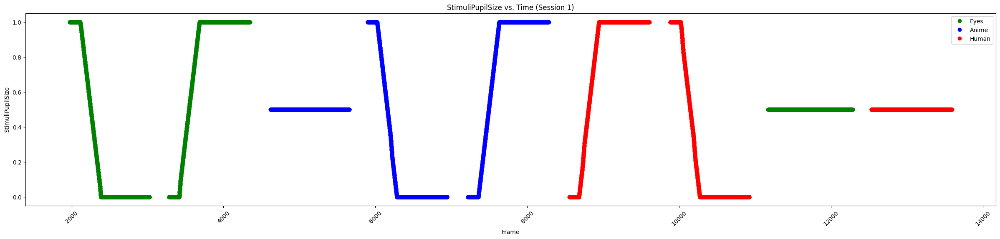

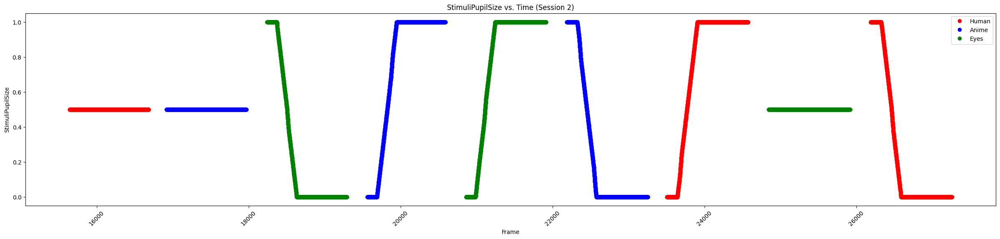

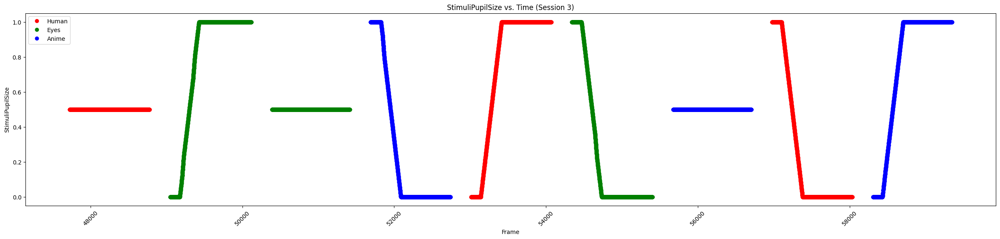

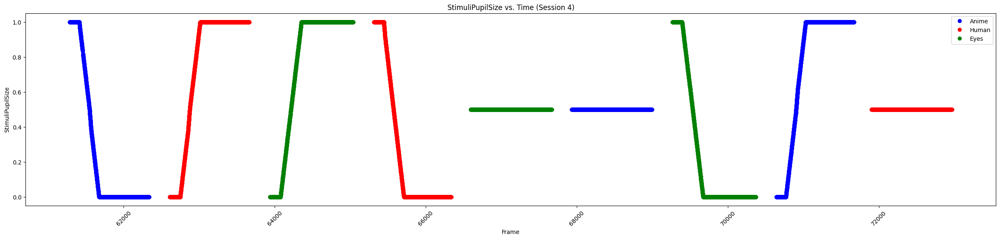

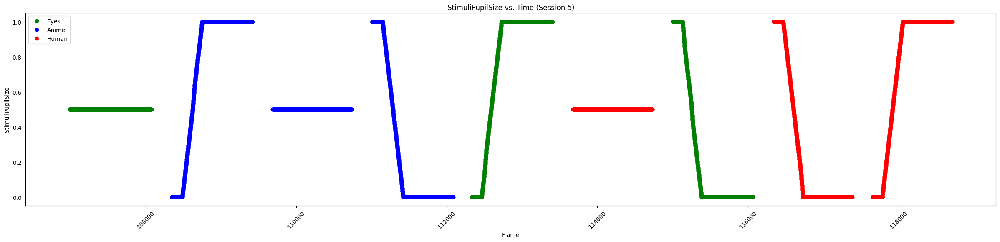

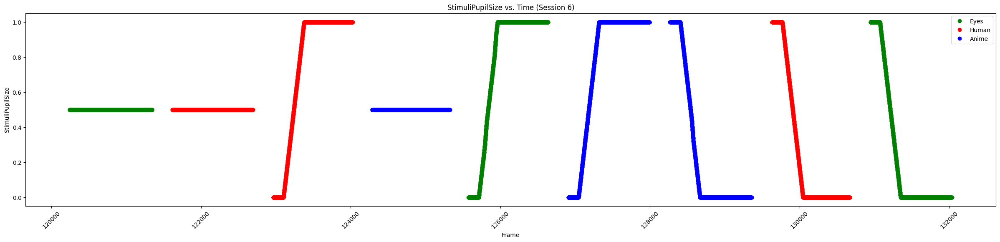

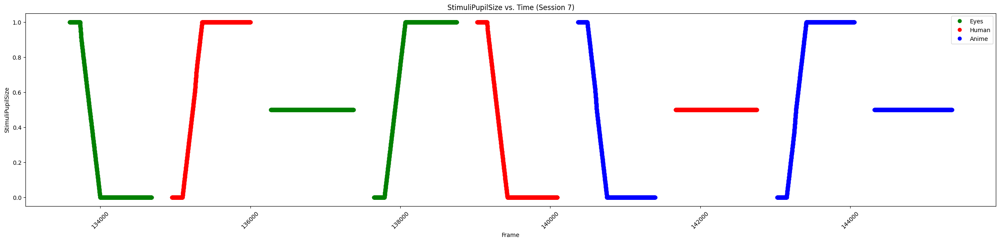

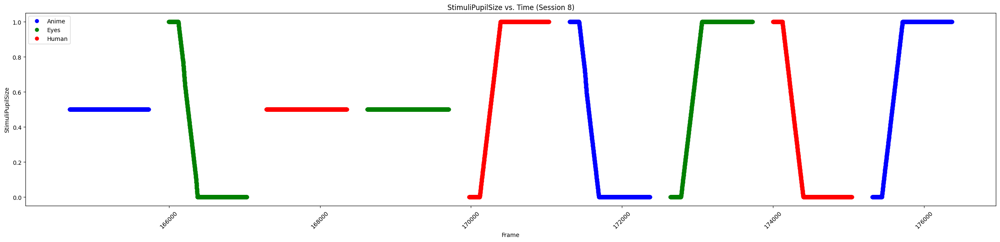

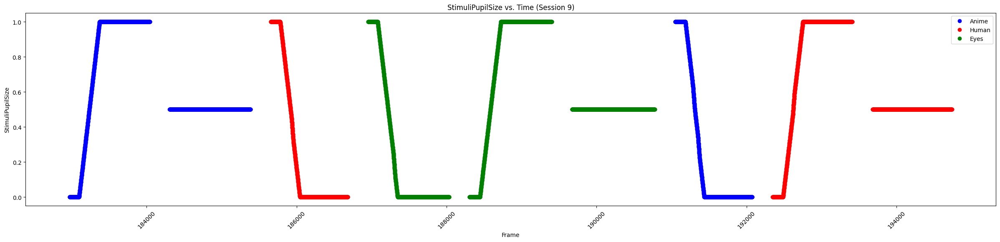

In [138]:
dataframe = processed_data

# Filter out rows with PupilDataActive equal to False
filtered_df = dataframe[dataframe['PupilDataActive'] == True]

# Get unique session values from the filtered DataFrame
sessions = filtered_df['CurrentSession'].unique()

# Create a separate plot for each session
for session in sessions:
    session_data = filtered_df[filtered_df['CurrentSession'] == session]
    plt.figure(figsize=(30, 6))
    for stimuli in session_data['CurrentStimuli'].unique():
        stimuli_data = session_data[session_data['CurrentStimuli'] == stimuli]
        plt.plot(stimuli_data['frame'], stimuli_data['StimuliPupilSize'], marker='o', linestyle='',
                 color=colors[stimuli], label=stimuli)

    plt.title(f"StimuliPupilSize vs. Time (Session {session})")
    plt.xlabel("Frame")
    plt.ylabel("StimuliPupilSize")
    plt.xticks(rotation=45)
    plt.legend()
    plt.show()


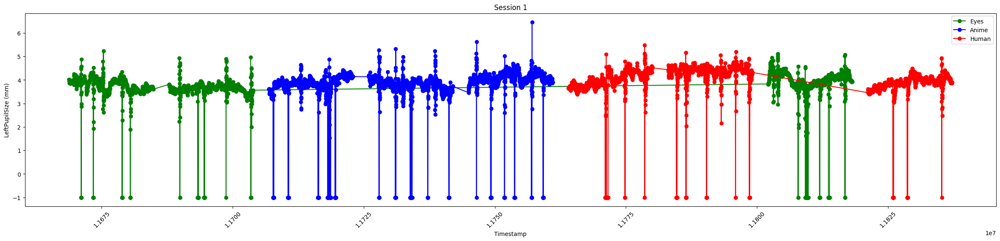

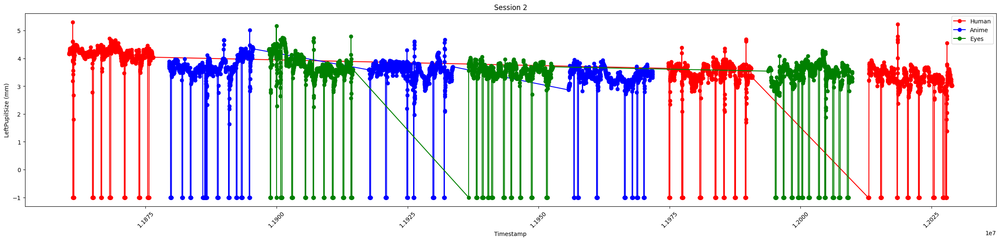

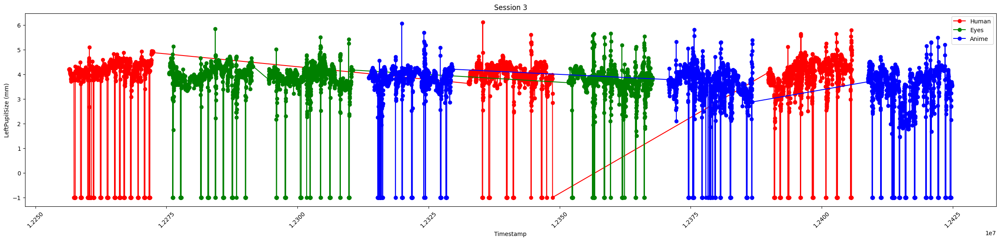

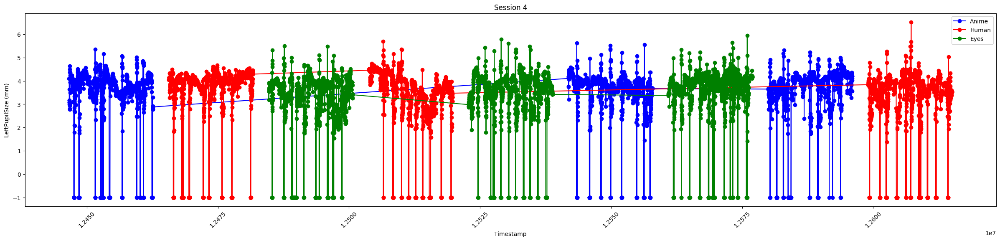

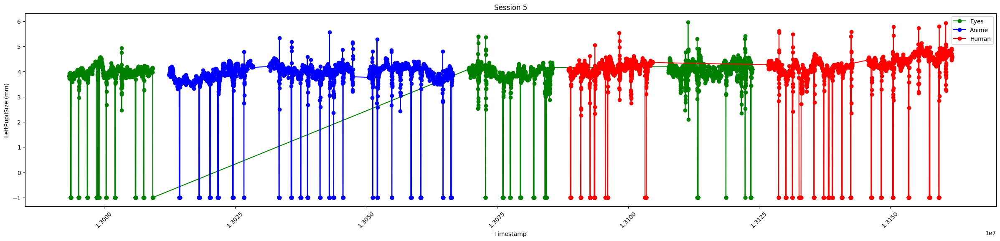

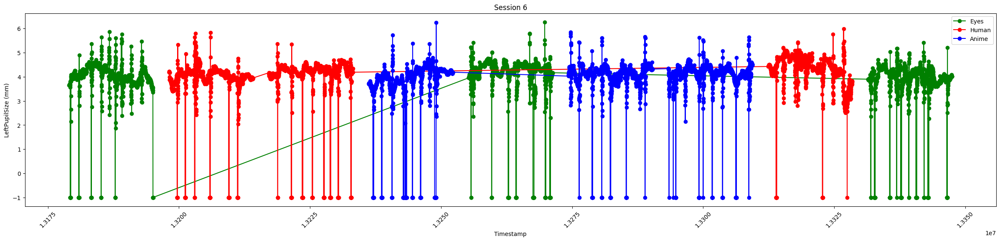

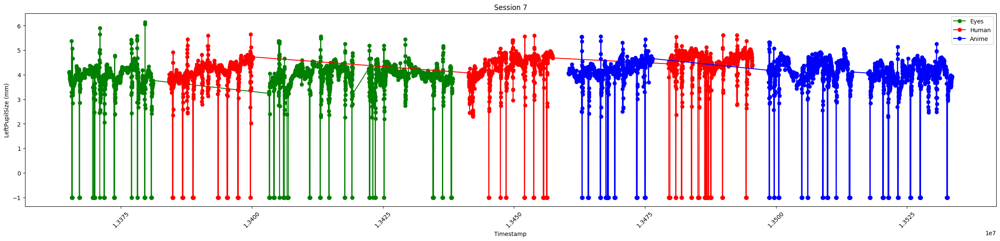

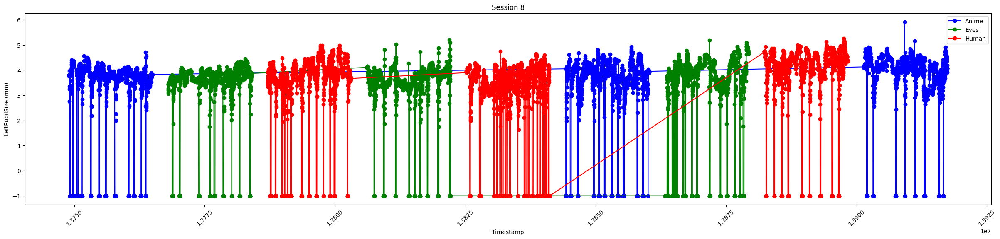

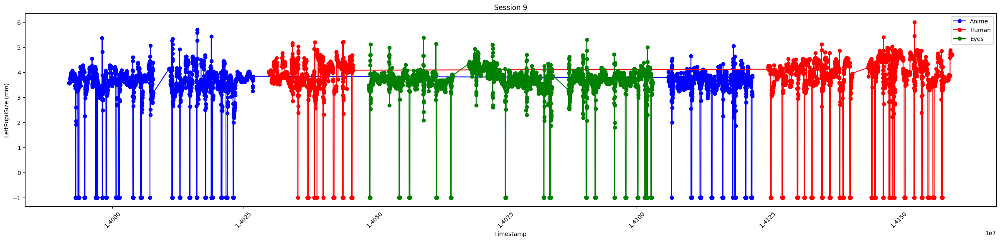

In [139]:
dataframe = processed_data

# Filter out rows with LeftPupilSize equal to -1 and PupilDataActive equal to False
filtered_df = dataframe[(dataframe['PupilDataActive'] == True)]

# Get unique session values from the filtered DataFrame
sessions = filtered_df['CurrentSession'].unique()

# Create a separate plot for each session
for session in sessions:
    session_data = filtered_df[filtered_df['CurrentSession'] == session]
    plt.figure(figsize=(30, 6))
    for stimuli, color in zip(session_data['CurrentStimuli'].unique(), colors):
        stimuli_data = session_data[session_data['CurrentStimuli'] == stimuli]
        plt.plot(stimuli_data['timestamp'], stimuli_data['pupilDia_L'], marker='o', linestyle='-', color=colors[stimuli], label=stimuli)
    plt.title(f"Session {session}")
    plt.xlabel("Timestamp")
    plt.ylabel("LeftPupilSize (mm)")
    plt.xticks(rotation=45)
    plt.legend()
    plt.show()


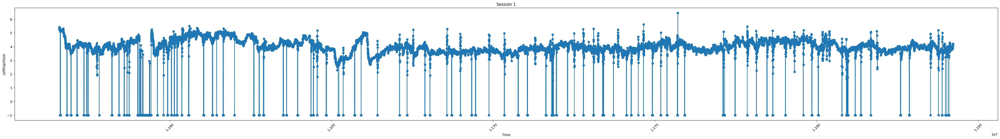

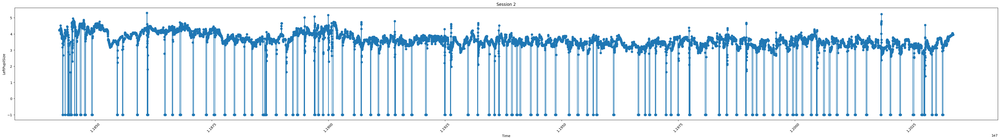

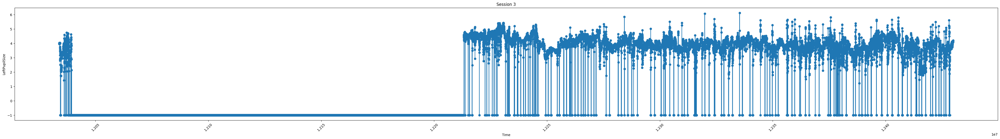

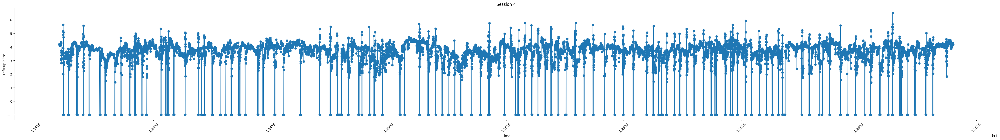

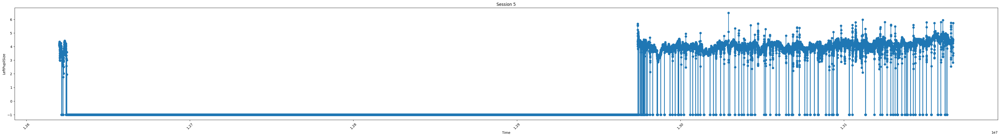

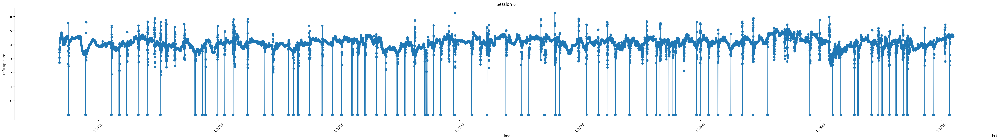

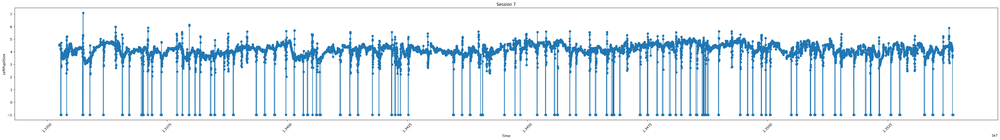

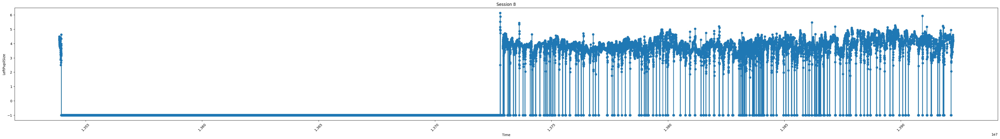

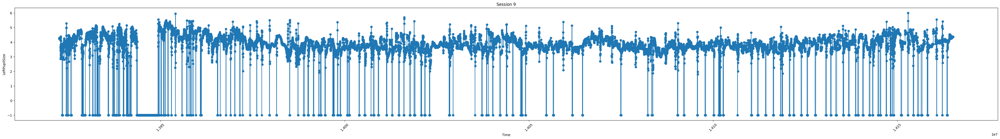

In [140]:
dataframe = processed_data
# Create a separate plot for each session
for session in sessions:
    session_data = dataframe[dataframe['CurrentSession'] == session]
    plt.figure(figsize=(52, 6))
    plt.plot(session_data['timestamp'], session_data['pupilDia_L'], marker='o', linestyle='-')
    plt.title(f"Session {session}")
    plt.xlabel("Time")
    plt.ylabel("LeftPupilSize")
    plt.xticks(rotation=45)
    plt.show()


### Every Stimuli separated

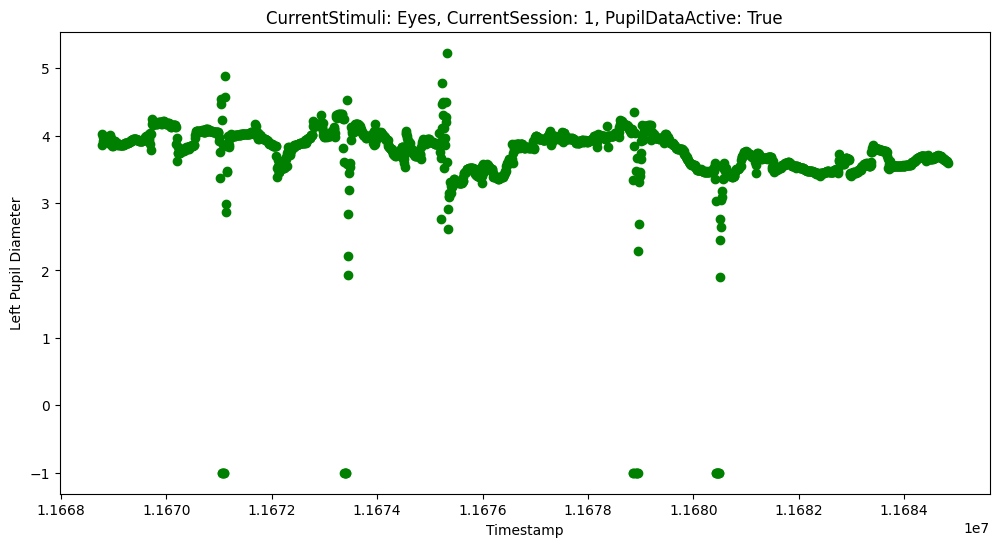

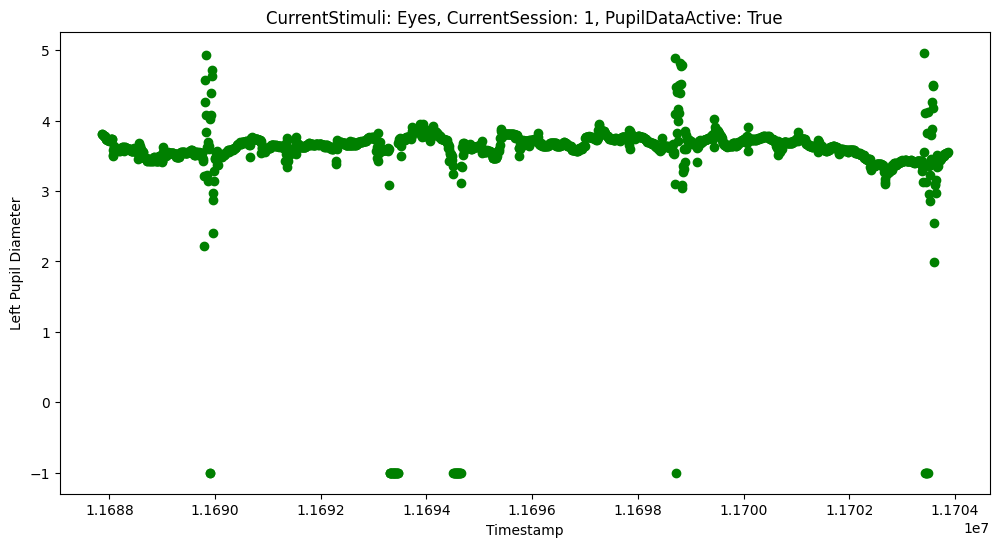

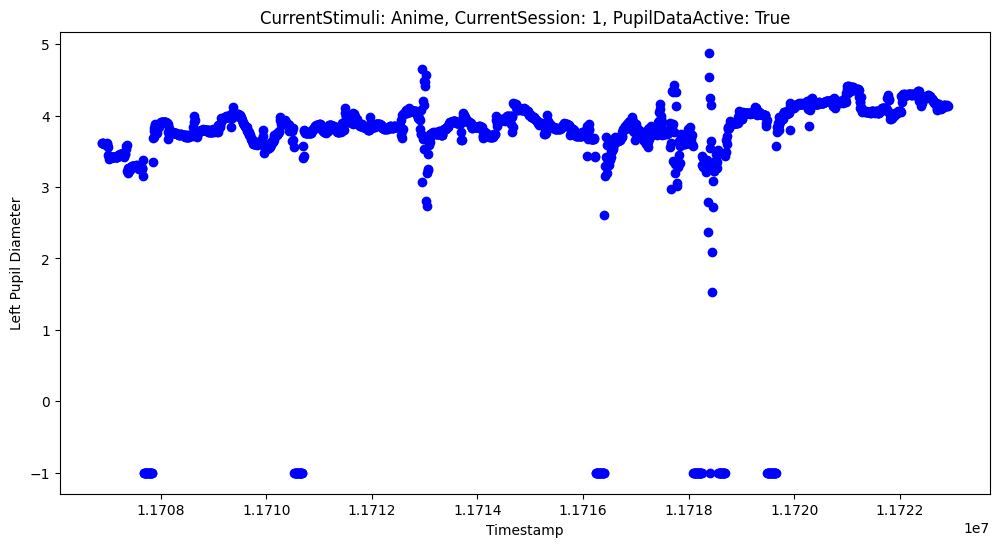

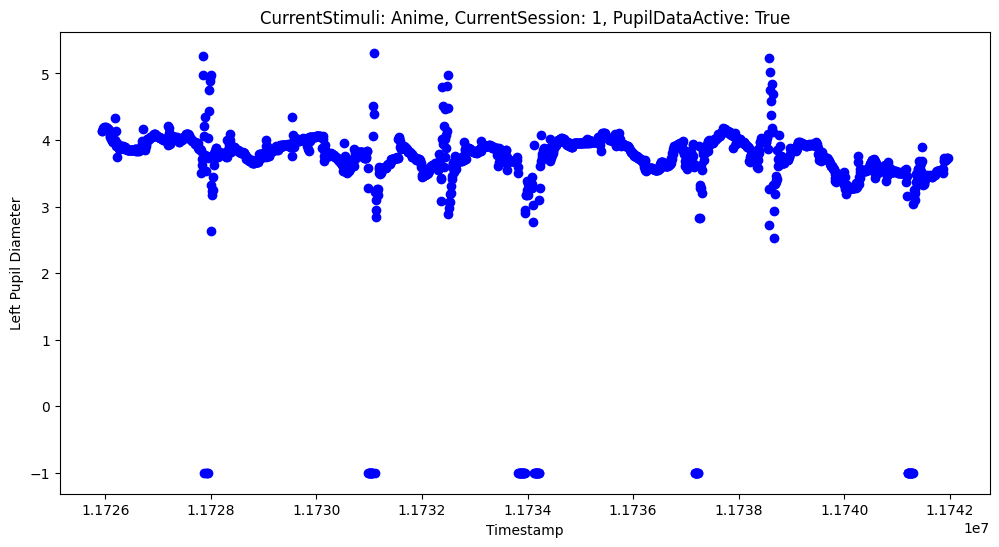

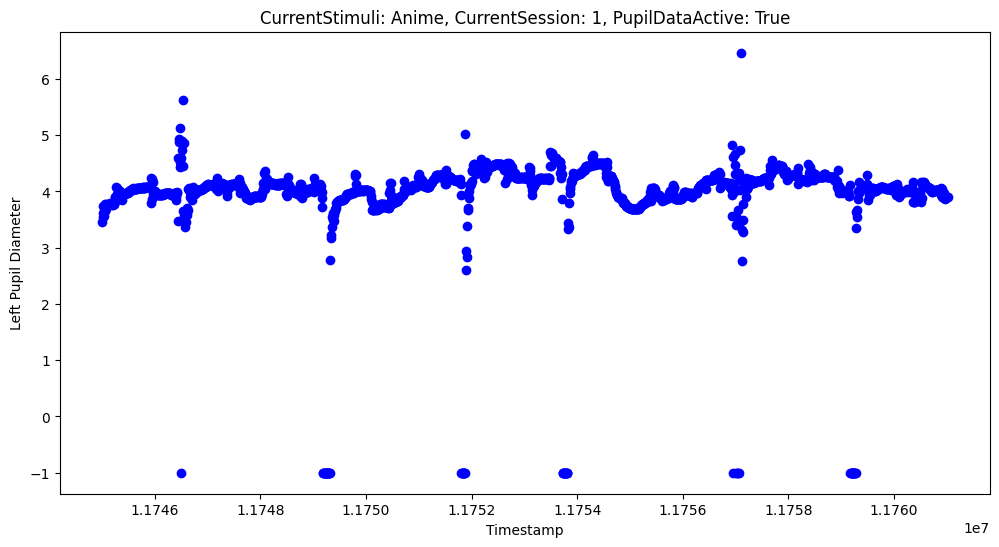

...

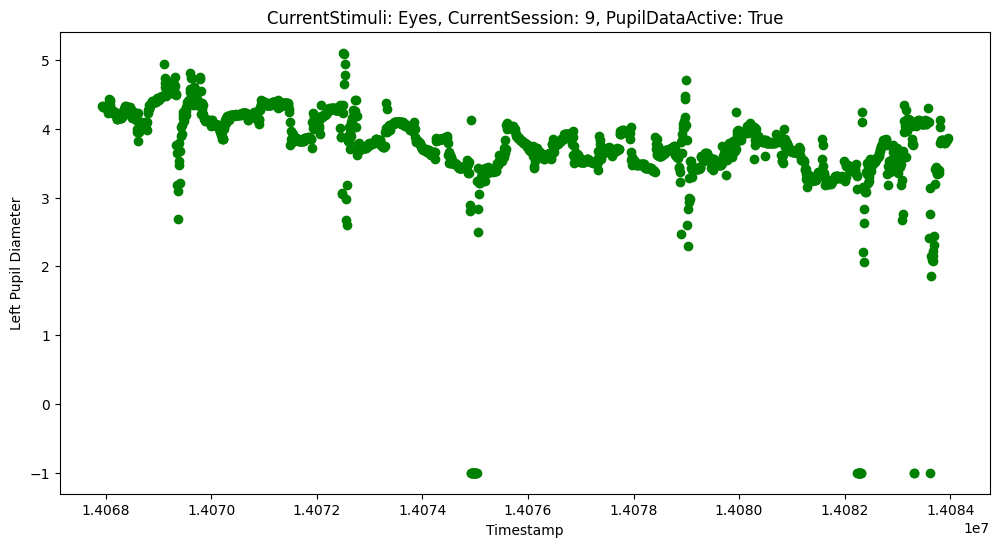

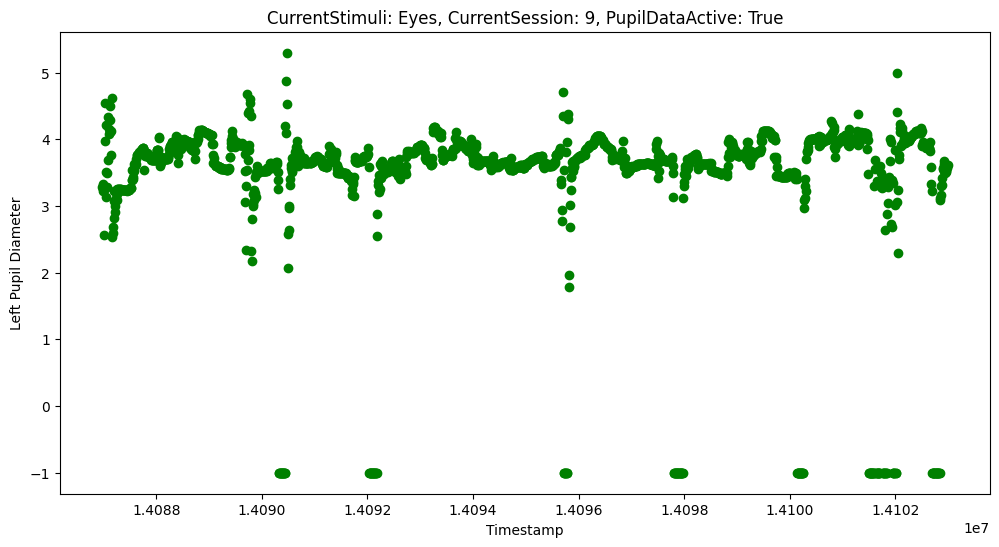

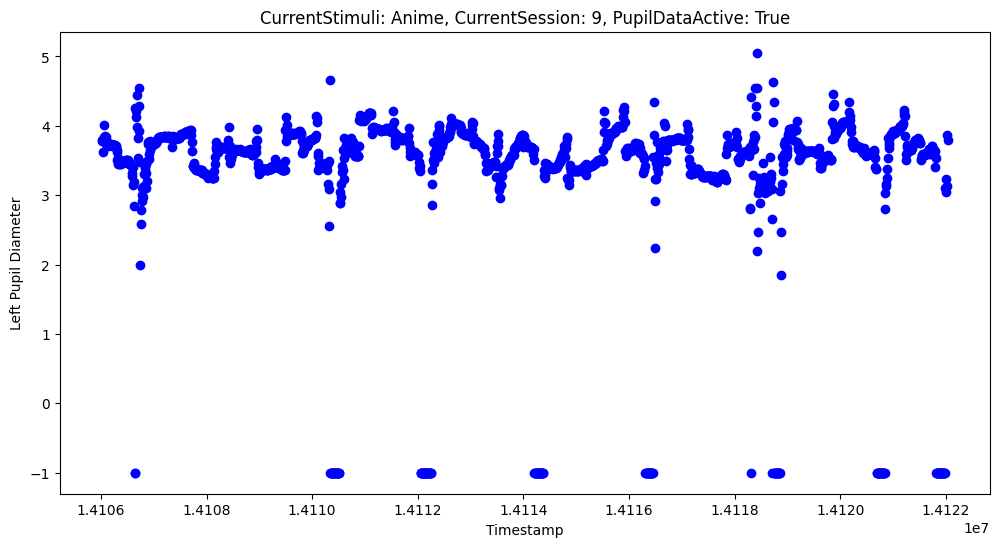

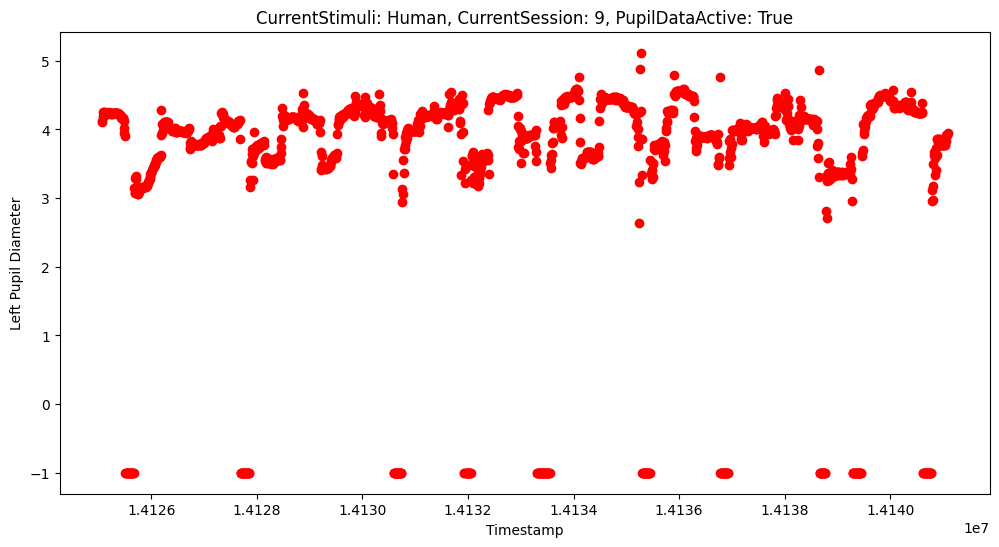

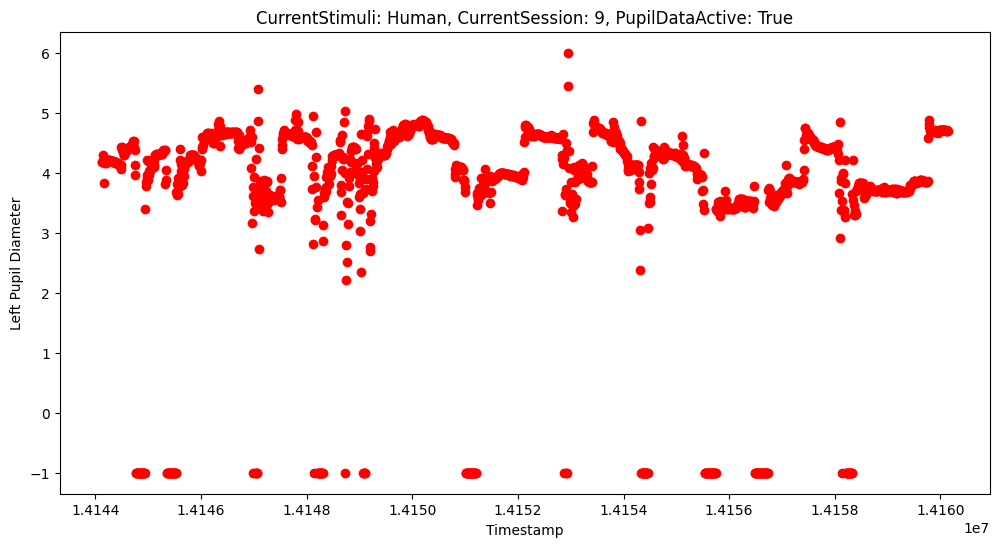

In [141]:
dataframe = processed_data

# Iterate over the data and create separate plots based on CurrentStimuli, CurrentSession, and PupilDataActive
previous_stimuli = None
previous_session = None
previous_active = False
current_plot = None

for index, row in dataframe.iterrows():
    timestamp = row['timestamp']
    pupil_dia_l = row['pupilDia_L']
    current_stimuli = row['CurrentStimuli']
    current_session = row['CurrentSession']
    current_active = row['PupilDataActive']

    if current_stimuli != previous_stimuli or current_session != previous_session or current_active != previous_active:
        # Create a new plot when CurrentStimuli, CurrentSession, or PupilDataActive changes
        if current_plot:
            plt.xlabel("Timestamp")
            plt.ylabel("Left Pupil Diameter")
            plt.title(f"CurrentStimuli: {previous_stimuli}, CurrentSession: {previous_session}, PupilDataActive: {previous_active}")
            plt.show()
            current_plot = None

    # Check if PupilDataActive is True
    if current_active:
        # Create a new plot for the current state of CurrentStimuli, CurrentSession, and PupilDataActive
        if current_plot is None:
            current_plot = plt.figure(figsize=(12, 6))

        # Plot the data point
        plt.plot(timestamp, pupil_dia_l, marker='o', linestyle='-', color=colors[current_stimuli])
        plt.xlabel("Timestamp")
        plt.ylabel("Left Pupil Diameter")
        plt.title(f"CurrentStimuli: {current_stimuli}, CurrentSession: {current_session}, PupilDataActive: {current_active}")

    previous_stimuli = current_stimuli
    previous_session = current_session
    previous_active = current_active

# Display the last plot if PupilDataActive is True
if current_plot:
    plt.xlabel("Timestamp")
    plt.ylabel("Left Pupil Diameter")
    plt.title(f"CurrentStimuli: {previous_stimuli}, CurrentSession: {previous_session}, PupilDataActive: {previous_active}")
    plt.show()


### Every Test separated

In [142]:
dataframe = processed_data

# Create a dictionary to store the resulting plots
test_dataframes = {}

# Initialize identifier counter
identifier_counter = 1
plot_counter = 1

# Iterate over the data and create separate plots based on CurrentStimuli, CurrentSession, and PupilDataActive
previous_stimuli = None
previous_session = None
previous_active = False
current_plot = None

for index, row in processed_data.iterrows():
    timestamp = row['frame']
    pupil_dia_l = row['pupilDia_L']
    current_stimuli = row['CurrentStimuli']
    current_session = row['CurrentSession']
    current_active = row['PupilDataActive']

    if current_stimuli != previous_stimuli or current_session != previous_session or current_active != previous_active:
        # Save the previous plot to the dictionary if it exists
        if current_plot:
            key = f"{previous_stimuli}_{plot_counter}"
            test_dataframes[key] = pd.DataFrame(current_plot, columns=processed_data.columns)
            current_plot = None
            plot_counter += 1

        # Increment the identifier counter
        identifier_counter += 1

    # Check if PupilDataActive is True
    if current_active:
        # Create a new plot for the current state of CurrentStimuli, CurrentSession, and PupilDataActive
        if current_plot is None:
            current_plot = []

        # Append the data point to the current plot
        current_plot.append(row)

    previous_stimuli = current_stimuli
    previous_session = current_session
    previous_active = current_active

# Save the last plot to the dictionary if PupilDataActive is True
if current_plot:
    key = f"{previous_stimuli}_{plot_counter}"
    test_dataframes[key] = pd.DataFrame(current_plot, columns=processed_data.columns)

# Access the resulting dataframes from the dictionary
for key, df in test_dataframes.items():
    stimuli = df['CurrentStimuli'].unique()[0]
    session = df['CurrentSession'].unique()[0]
    print(f"Dataframe: {key}, Test: {stimuli}, CurrentSession: {session}")
    print(f"Number of Rows: {len(df)}")
    print()


Dataframe: Eyes_1, Test: Eyes, CurrentSession: 1
Number of Rows: 1923

Dataframe: Eyes_2, Test: Eyes, CurrentSession: 1
Number of Rows: 1921

Dataframe: Anime_3, Test: Anime, CurrentSession: 1
Number of Rows: 1923

Dataframe: Anime_4, Test: Anime, CurrentSession: 1
Number of Rows: 1924

Dataframe: Anime_5, Test: Anime, CurrentSession: 1
Number of Rows: 1923

Dataframe: Human_6, Test: Human, CurrentSession: 1
Number of Rows: 1922

Dataframe: Human_7, Test: Human, CurrentSession: 1
Number of Rows: 1923

Dataframe: Eyes_8, Test: Eyes, CurrentSession: 1
Number of Rows: 1924

Dataframe: Human_9, Test: Human, CurrentSession: 1
Number of Rows: 1923

Dataframe: Human_10, Test: Human, CurrentSession: 2
Number of Rows: 1925

Dataframe: Anime_11, Test: Anime, CurrentSession: 2
Number of Rows: 1924

Dataframe: Eyes_12, Test: Eyes, CurrentSession: 2
Number of Rows: 1922

Dataframe: Anime_13, Test: Anime, CurrentSession: 2
Number of Rows: 1925

Dataframe: Eyes_14, Test: Eyes, CurrentSession: 2
Numbe

###Remove empty Tests

In [143]:
# Create a new dictionary to store the filtered dataframes
final_test_dataframes = {name: testDataFrame for name, testDataFrame in test_dataframes.items() if len(testDataFrame) > 10}

# Print the filtered dataframes
for name, testDataFrame in final_test_dataframes.items():
    print(f"Dataframe: {name}")

print(len(final_test_dataframes))

Dataframe: Eyes_1
Dataframe: Eyes_2
Dataframe: Anime_3
Dataframe: Anime_4
Dataframe: Anime_5
Dataframe: Human_6
Dataframe: Human_7
Dataframe: Eyes_8
Dataframe: Human_9
Dataframe: Human_10
Dataframe: Anime_11
Dataframe: Eyes_12
Dataframe: Anime_13
Dataframe: Eyes_14
Dataframe: Anime_15
Dataframe: Human_16
Dataframe: Eyes_17
Dataframe: Human_18
Dataframe: Human_19
Dataframe: Eyes_20
Dataframe: Eyes_21
Dataframe: Anime_22
Dataframe: Human_23
Dataframe: Eyes_24
Dataframe: Anime_25
Dataframe: Human_26
Dataframe: Anime_27
Dataframe: Anime_28
Dataframe: Human_29
Dataframe: Eyes_30
Dataframe: Human_31
Dataframe: Eyes_32
Dataframe: Anime_33
Dataframe: Eyes_34
Dataframe: Anime_35
Dataframe: Human_36
Dataframe: Eyes_37
Dataframe: Anime_38
Dataframe: Anime_39
Dataframe: Anime_40
Dataframe: Eyes_41
Dataframe: Human_42
Dataframe: Eyes_43
Dataframe: Human_44
Dataframe: Human_45
Dataframe: Eyes_46
Dataframe: Human_47
Dataframe: Human_48
Dataframe: Anime_49
Dataframe: Eyes_50
Dataframe: Anime_51
Datafr

## Pupil data with stimuli


## Convert timestamp to real time

In [144]:
# Iterate over the test_dataframes dictionary
for name, testDataFrame in test_dataframes.items():

    test = testDataFrame.sort_values('timestamp')

    first_time = testDataFrame['timestamp'].iloc[0]
    last_time = testDataFrame['timestamp']
    time_difference = last_time - first_time

    print(first_time)
    print(last_time)
    print(time_difference)

    # Convert the timestamp column to seconds
    testDataFrame['RealTime'] = time_difference / 1000  # Assuming timestamp is in milliseconds
    print(f"DataFrame: {name}")
    print(testDataFrame)

Streaming output truncated to the last 5000 lines.
102981       -18.59338     0.057846  ...           Anime               0.0   
102982       -18.59081     0.058075  ...           Anime               0.0   
102983       -18.58932     0.058258  ...           Anime               0.0   
102984       -18.58784     0.058456  ...           Anime               0.0   

        StimuliEndSize  StimuliPupilSize  PupilSizeChanging  PupilDataActive  \
101061             1.0               0.0              False             True   
101062             1.0               0.0              False             True   
101063             1.0               0.0              False             True   
101064             1.0               0.0              False             True   
101065             1.0               0.0              False             True   
...                ...               ...                ...              ...   
102980             1.0               1.0              False             True

### Output a dataframe to test

Dataframe 'Anime_3' exported to 'Anime_3_dataframe.csv'


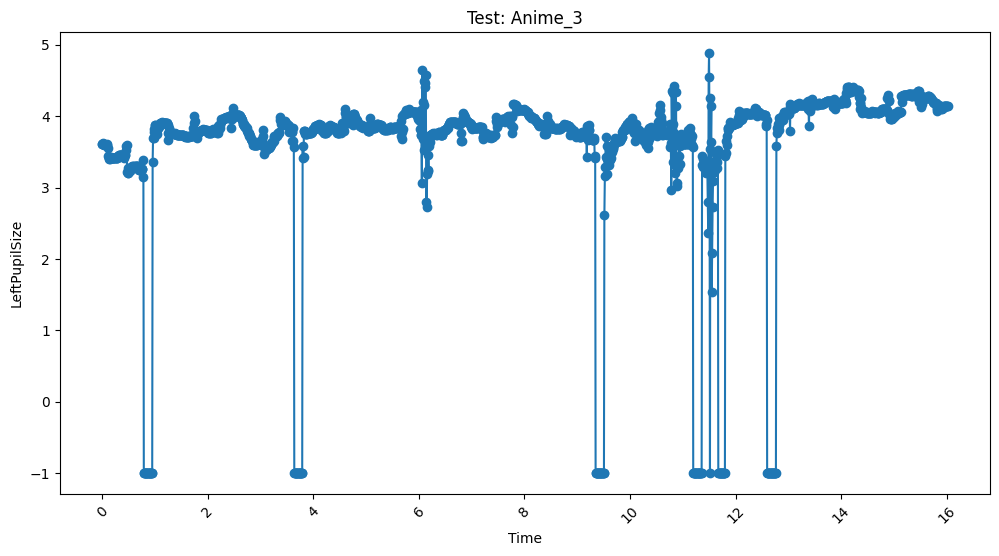

                         Time  frame  timestamp  gazeOrigin_L.X  \
16839 1900-01-01 13:00:08.747   4621   11706891        27.52184   
16840 1900-01-01 13:00:08.747   4621   11706899        27.52832   
16841 1900-01-01 13:00:08.762   4622   11706908        27.53210   
16842 1900-01-01 13:00:08.762   4622   11706916        27.53448   
16843 1900-01-01 13:00:08.776   4623   11706924        27.53934   
...                       ...    ...        ...             ...   
18757 1900-01-01 13:00:24.723   5655   11722871        28.68008   
18758 1900-01-01 13:00:24.723   5655   11722879        28.67865   
18759 1900-01-01 13:00:24.737   5656   11722887        28.67847   
18760 1900-01-01 13:00:24.737   5656   11722896        28.67825   
18761 1900-01-01 13:00:24.753   5657   11722904        28.67365   

       gazeOrigin_L.Y  gazeOrigin_L.Z  gazeOrigin_R.X  gazeOrigin_R.Y  \
16839        3.447403       -17.85716       -29.51797        0.788651   
16840        3.447403       -17.85716       -29.5

In [145]:
def output_dataframe(dictionary_name, output_file):
    if dictionary_name in test_dataframes:
        currentTestDf = test_dataframes[dictionary_name]
        currentTestDf.to_csv(output_file, index=False)  # Export dataframe to CSV
        print(f"Dataframe '{dictionary_name}' exported to '{output_file}'")

        plt.figure(figsize=(12, 6))
        plt.plot(currentTestDf['RealTime'], currentTestDf['pupilDia_L'], marker='o', linestyle='-')
        plt.title(f"Test: {dictionary_name}")
        plt.xlabel("Time")
        plt.ylabel("LeftPupilSize")
        plt.xticks(rotation=45)
        plt.show()
    else:
        print(f"The dictionary '{dictionary_name}' does not exist.")

dictionary_name = "Anime_3"
output_file = dictionary_name + "_dataframe.csv"
newDataTest = test_dataframes[dictionary_name]
output_dataframe(dictionary_name, output_file)
print(newDataTest)


In [146]:
sessions = processed_data['CurrentSession'].unique()
print("Sessions with data:")
for session in sessions:
    print(session)


Sessions with data:
1
2
3
4
5
6
7
8
9


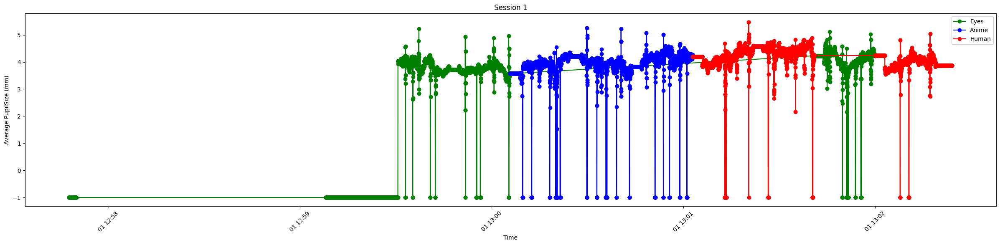

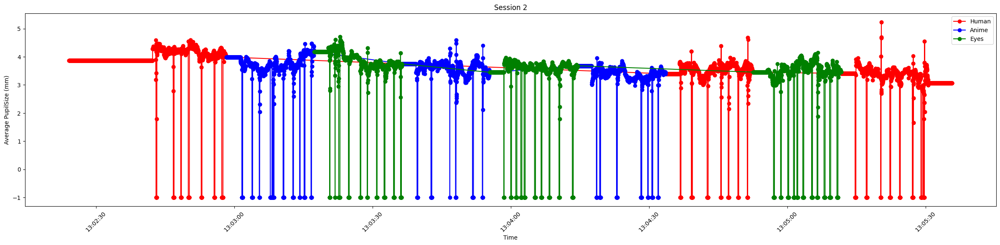

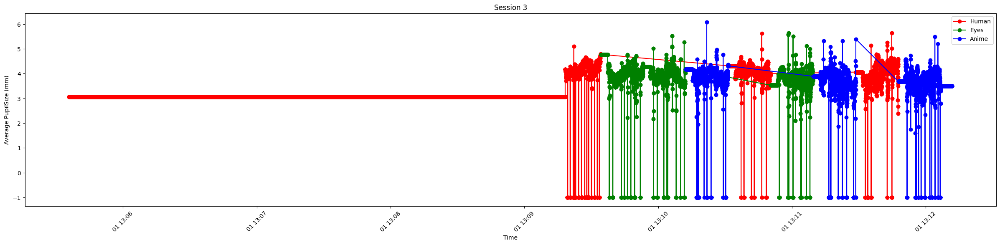

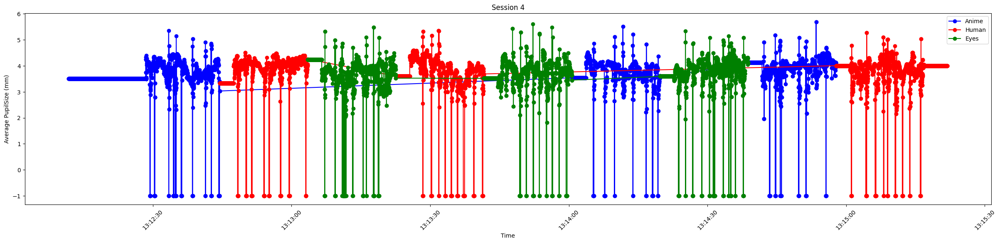

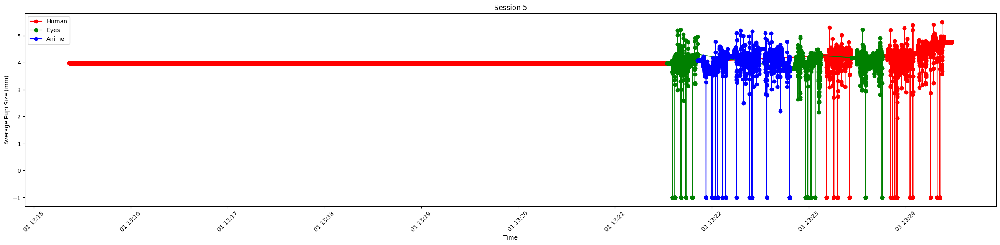

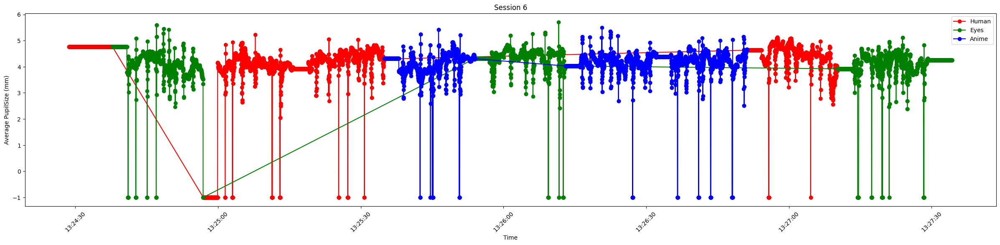

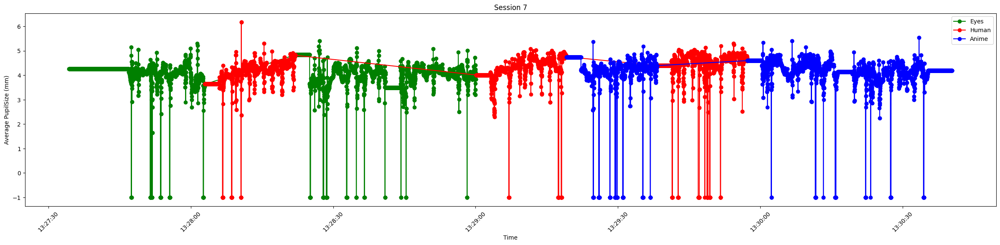

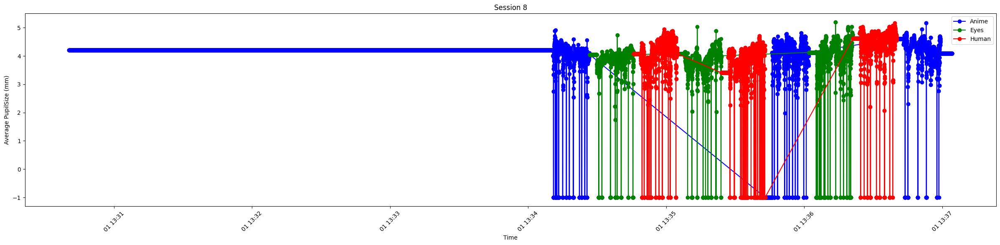

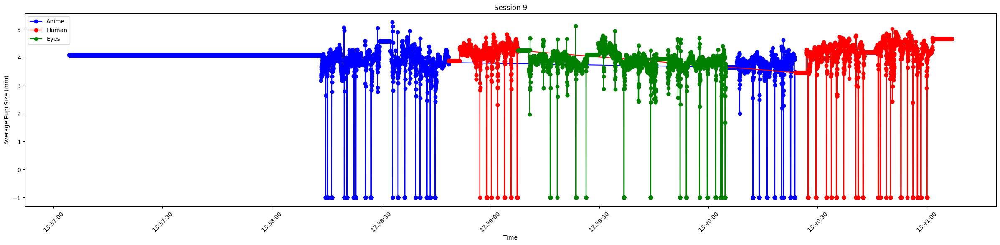

In [147]:
dataframe = processed_data
# Create a separate plot for each session
for session in sessions:
    session_data = processed_data[processed_data['CurrentSession'] == session]
    plt.figure(figsize=(30, 6))
    for stimuli, color in zip(session_data['CurrentStimuli'].unique(), colors):
        stimuli_data = session_data[session_data['CurrentStimuli'] == stimuli]
        plt.plot(stimuli_data['Time'], stimuli_data['AveragePupilSize'], marker='o', linestyle='-',  color=colors[stimuli] , label=stimuli)
    plt.title(f"Session {session}")
    plt.xlabel("Time")
    plt.ylabel("Average PupilSize (mm)")
    plt.xticks(rotation=45)
    plt.legend()
    plt.show()


### Median Filter to remove noise (TBD)

### Pupil Size and Stimuli Pupil

# Testing Pyplr


In [148]:
!pip install pyplr
from pyplr import graphing, utils, preproc
from pyplr.plr import PLR

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.1/23.1 MB 8.9 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 96.8 MB/s eta 0:00:00
  Created wheel for pyplr: filename=pyplr-1.0.3-py3-none-any.whl size=81125 sha256=e65ddabf0e49562f7bdc062991e6302d23c6f9679878a8fa8e4f35ff603f18de
  Stored in directory: /root/.cache/pip/wheels/3c/23/eb/40adce03f3811ee68d1eba88f4b55547e15cbfb92079c532ef
Successfully built pyplr


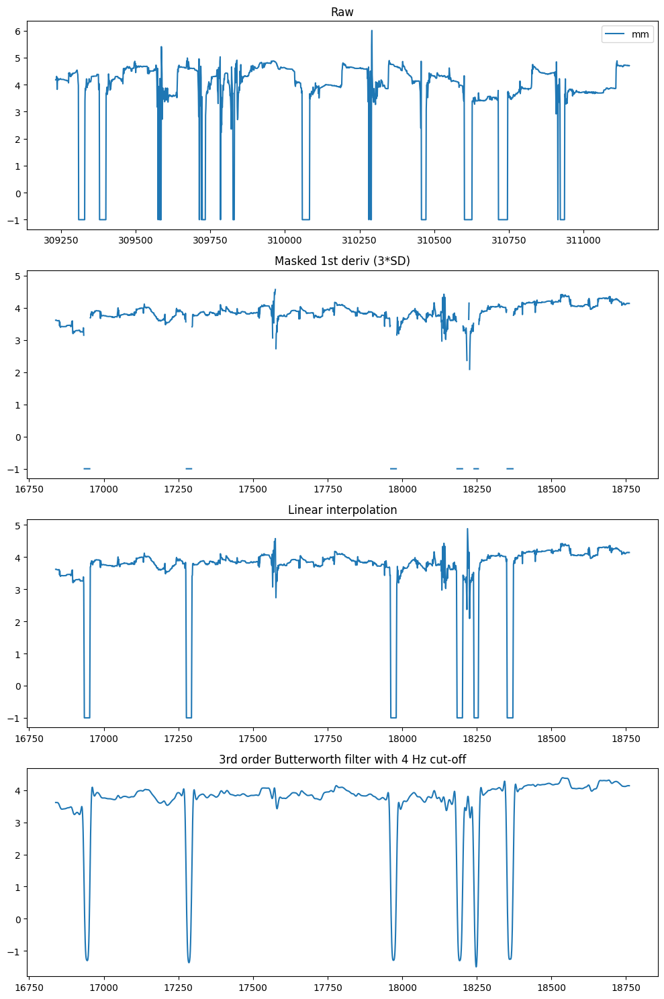

In [149]:
import pandas as pd
import matplotlib.pyplot as plt
from pyplr import preproc

# Sampling frequency
SAMPLE_RATE = 60

# Pupil columns to analyse
pupil_cols = ['pupilDia_L']
samples = newDataTest

# Create the figure and axes
fig, axs = plt.subplots(nrows=4, figsize=(10, 15))

# Plot the raw data
axs[0].plot(df[pupil_cols])
axs[0].set_title('Raw')
axs[0].legend(['mm', 'pixels'])

# Mask first derivative
samples = preproc.mask_pupil_first_derivative(
    samples, threshold=3.0, mask_cols=pupil_cols)
axs[1].plot(samples[pupil_cols])
axs[1].set_title('Masked 1st deriv (3*SD)')

# Interpolate
samples = preproc.interpolate_pupil(
    samples, interp_cols=pupil_cols)
axs[2].plot(samples[pupil_cols])
axs[2].set_title('Linear interpolation')

# Smooth
samples = preproc.butterworth_series(
    samples, fields=pupil_cols, filt_order=3,
    cutoff_freq=4/(SAMPLE_RATE/2))
axs[3].plot(samples[pupil_cols])
axs[3].set_title('3rd order Butterworth filter with 4 Hz cut-off')

# Adjust the layout
plt.tight_layout()

# Show the figure
plt.show()


In [150]:
import pandas as pd
from IPython.display import display

# Interpolate
interpolated_data = preproc.interpolate_pupil(samples, interp_cols=pupil_cols)

# Create a DataFrame from the interpolated data
interpolated_df = pd.DataFrame(interpolated_data, columns=pupil_cols)

# Display the DataFrame
display(interpolated_df)


,pupilDia_L
16839,3.617088
16840,3.616355
16841,3.616120
16842,3.616200
16843,3.616276
...,...
18757,4.141424
18758,4.141675
18759,4.141412
18760,4.140812


In [151]:
# Output the DataFrame to a CSV file
interpolated_df.to_csv('interpolated_data.csv', index=False)


# Pupil analysis and comparison

In [152]:
# Print the created dataframes
for name, testDataFrame in test_dataframes.items():
    print(f"Dataframe: {name}")
    #print(testDataFrame)
    #print()


Dataframe: Eyes_1
Dataframe: Eyes_2
Dataframe: Anime_3
Dataframe: Anime_4
Dataframe: Anime_5
Dataframe: Human_6
Dataframe: Human_7
Dataframe: Eyes_8
Dataframe: Human_9
Dataframe: Human_10
Dataframe: Anime_11
Dataframe: Eyes_12
Dataframe: Anime_13
Dataframe: Eyes_14
Dataframe: Anime_15
Dataframe: Human_16
Dataframe: Eyes_17
Dataframe: Human_18
Dataframe: Human_19
Dataframe: Eyes_20
Dataframe: Eyes_21
Dataframe: Anime_22
Dataframe: Human_23
Dataframe: Eyes_24
Dataframe: Anime_25
Dataframe: Human_26
Dataframe: Anime_27
Dataframe: Anime_28
Dataframe: Human_29
Dataframe: Eyes_30
Dataframe: Human_31
Dataframe: Eyes_32
Dataframe: Anime_33
Dataframe: Eyes_34
Dataframe: Anime_35
Dataframe: Human_36
Dataframe: Eyes_37
Dataframe: Anime_38
Dataframe: Anime_39
Dataframe: Anime_40
Dataframe: Eyes_41
Dataframe: Human_42
Dataframe: Eyes_43
Dataframe: Human_44
Dataframe: Human_45
Dataframe: Eyes_46
Dataframe: Human_47
Dataframe: Human_48
Dataframe: Anime_49
Dataframe: Eyes_50
Dataframe: Anime_51
Datafr

##Manual Interpolation

In [153]:
SAMPLE_RATE = 60
time_perTest = 19

### Export every test to zip

In [154]:
import os
import zipfile

# Create a folder called "Tests" if it doesn't exist
folder_name = "Tests"
if not os.path.exists(folder_name):
    os.makedirs(folder_name)

for name, currentTestdf in test_dataframes.items():
    currentTestdf['Time'] = pd.to_datetime(currentTestdf['Time'])
    currentTestdf = currentTestdf.sort_values('Time')

    first_time = currentTestdf['Time'].iloc[0]
    last_time = currentTestdf['Time'].iloc[-1]
    time_difference = last_time - first_time
    row_count = len(currentTestdf)

    print(f"Dataframe: {name}")
    print(f"Total time difference: {time_difference}")
    print(f"Number of rows: {row_count}")

    # Export the dataframe to a CSV file in the "Tests" folder
    file_path = os.path.join(folder_name, f"{name}.csv")
    currentTestdf.to_csv(file_path, index=False)
    print(f"Exported to: {file_path}\n")

# Zip the "Tests" folder
zip_file_name = "Tests.zip"
with zipfile.ZipFile(zip_file_name, "w") as zipf:
    for root, _, files in os.walk(folder_name):
        for file in files:
            file_path = os.path.join(root, file)
            zipf.write(file_path, os.path.basename(file_path))

print(f"Zip file created: {zip_file_name}")


Dataframe: Eyes_1
Total time difference: 0 days 00:00:16.029000
Number of rows: 1923
Exported to: Tests/Eyes_1.csv

Dataframe: Eyes_2
Total time difference: 0 days 00:00:15.989000
Number of rows: 1921
Exported to: Tests/Eyes_2.csv

Dataframe: Anime_3
Total time difference: 0 days 00:00:16.006000
Number of rows: 1923
Exported to: Tests/Anime_3.csv

Dataframe: Anime_4
Total time difference: 0 days 00:00:16.011000
Number of rows: 1924
Exported to: Tests/Anime_4.csv

Dataframe: Anime_5
Total time difference: 0 days 00:00:16.006000
Number of rows: 1923
Exported to: Tests/Anime_5.csv

Dataframe: Human_6
Total time difference: 0 days 00:00:16
Number of rows: 1922
Exported to: Tests/Human_6.csv

Dataframe: Human_7
Total time difference: 0 days 00:00:16.010000
Number of rows: 1923
Exported to: Tests/Human_7.csv

Dataframe: Eyes_8
Total time difference: 0 days 00:00:16.008000
Number of rows: 1924
Exported to: Tests/Eyes_8.csv

Dataframe: Human_9
Total time difference: 0 days 00:00:16.007000
Numb

### Resample datasets

In [155]:
for name, currentTestdf in test_dataframes.items():
    currentTestdf = currentTestdf.copy()  # Create a copy of the dataframe
    currentTestdf['RealTime'] = pd.to_datetime(currentTestdf['RealTime'], unit='ms')  # Specify the unit as milliseconds
    currentTestdf = currentTestdf.set_index('RealTime').sort_index()

    first_time = currentTestdf.index[0]
    last_time = currentTestdf.index[-1]
    total_time = last_time - first_time

    row_count = len(currentTestdf)
    frequency = row_count / total_time.total_seconds()  # Calculate the frequency

    print(f"DataFrame: {name}, Total Time: {total_time.total_seconds() * 1000} ms, Number of Rows: {row_count}, Frequency: {frequency} Hz")


DataFrame: Eyes_1, Total Time: 16.039 ms, Number of Rows: 1923, Frequency: 119895.25531516927 Hz
DataFrame: Eyes_2, Total Time: 15.996 ms, Number of Rows: 1921, Frequency: 120092.52313078269 Hz
DataFrame: Anime_3, Total Time: 16.012999999999998 ms, Number of Rows: 1923, Frequency: 120089.92693436584 Hz
DataFrame: Anime_4, Total Time: 16.021 ms, Number of Rows: 1924, Frequency: 120092.37875288683 Hz
DataFrame: Anime_5, Total Time: 16.014 ms, Number of Rows: 1923, Frequency: 120082.42787560885 Hz
DataFrame: Human_6, Total Time: 16.004 ms, Number of Rows: 1922, Frequency: 120094.97625593601 Hz
DataFrame: Human_7, Total Time: 16.012999999999998 ms, Number of Rows: 1923, Frequency: 120089.92693436584 Hz
DataFrame: Eyes_8, Total Time: 16.021 ms, Number of Rows: 1924, Frequency: 120092.37875288683 Hz
DataFrame: Human_9, Total Time: 16.012999999999998 ms, Number of Rows: 1923, Frequency: 120089.92693436584 Hz
DataFrame: Human_10, Total Time: 16.029999999999998 ms, Number of Rows: 1925, Frequen

## Remove Blinks

In [170]:
surroundAmount = 10  # Change this value as needed

In [201]:
# Iterate over the test_dataframes dictionary
for name, testDataFrame in test_dataframes.items():
    processed_pupil_left = testDataFrame['pupilDia_L'].copy()
    testDataFrame['RealTime'] = pd.to_datetime(testDataFrame['RealTime'], unit='ms')  # Convert RealTime to datetime

    for i in range(len(testDataFrame)):
        if testDataFrame['pupilDia_L'].iloc[i] < 0:
            # Find the start and end indices of surrounding values
            start_idx = max(0, i - surroundAmount)
            end_idx = min(len(testDataFrame), i + surroundAmount + 1)
            # Remove the surrounding values by setting them to None
            processed_pupil_left.iloc[start_idx:end_idx] = None

    # Replace -1 values with None
    processed_pupil_left.replace(-1, None, inplace=True)

    # Assign the processed values back to the original dataframe
    testDataFrame['processedPupil_Left'] = processed_pupil_left


In [202]:
for name, testDataFrame in test_dataframes.items():
    rows_with_negative_ones = testDataFrame[testDataFrame['processedPupil_Left'] == -1]
    print(f"DataFrame: {name}")
    print(rows_with_negative_ones)
    print()


DataFrame: Eyes_1
Empty DataFrame
Columns: [Time, frame, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 39 columns]

DataFrame: Eyes_2
Empty DataFrame
Columns: [Time, frame, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, Uni

### Fill with Linear Interpolation

In [203]:
# Iterate over the test_dataframes dictionary
for name, testDataFrame in test_dataframes.items():
    testDataFrame['RealTime'] = pd.to_datetime(testDataFrame['RealTime'], unit='ms')  # Convert RealTime to datetime

    # Create a copy of the 'processedPupil_Left' column
    processed_pupil_left = testDataFrame['processedPupil_Left'].copy()

    # Convert the 'processedPupil_Left' column to numeric
    processed_pupil_left = pd.to_numeric(processed_pupil_left, errors='coerce')

    # Fill None values using linear interpolation
    interpolated_values = processed_pupil_left.interpolate()

    # Add the interpolated values as a new column
    testDataFrame['processedPupil_Left'] = interpolated_values

### Plots with data interpolated

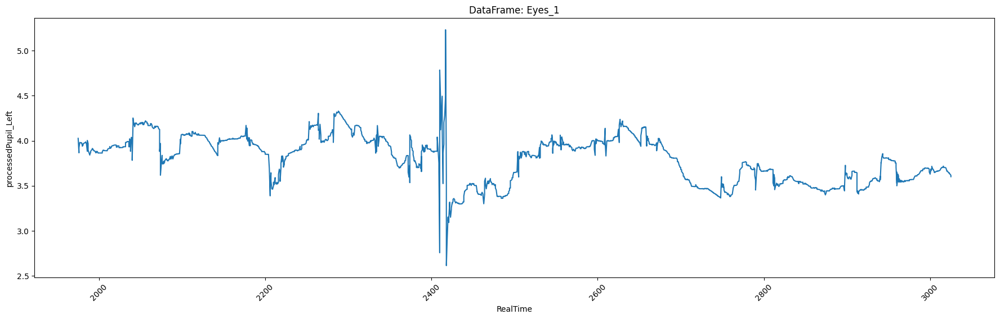

DataFrame: Eyes_1
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



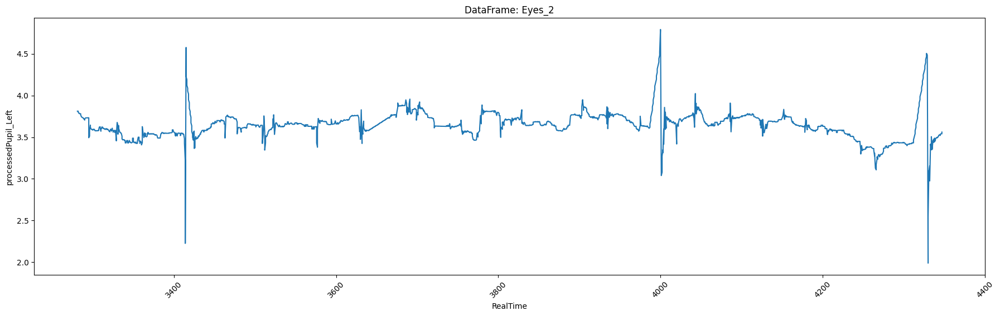

DataFrame: Eyes_2
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



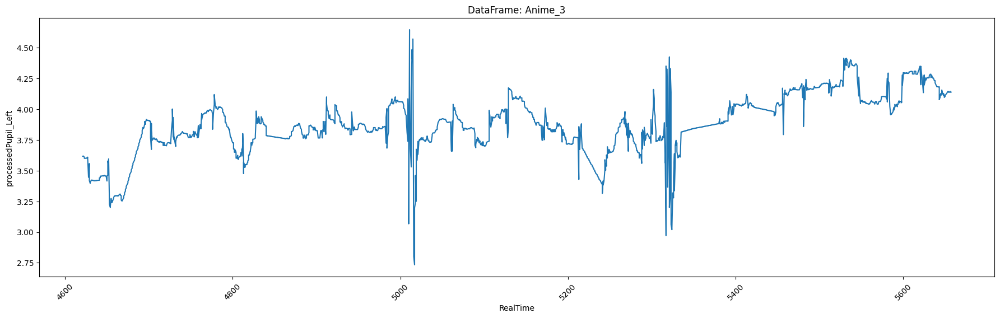

DataFrame: Anime_3
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



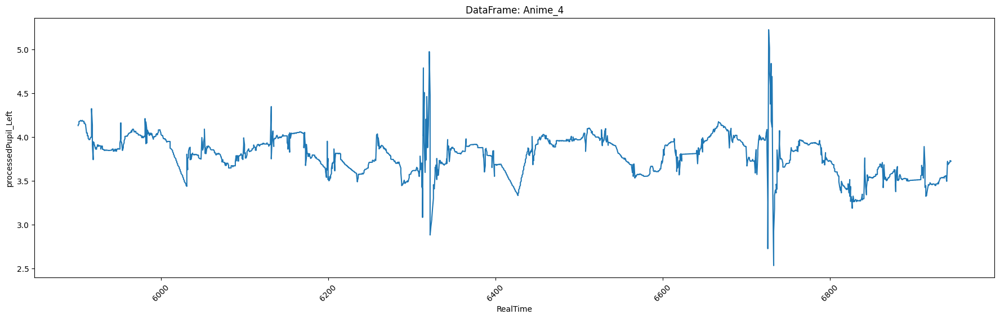

DataFrame: Anime_4
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



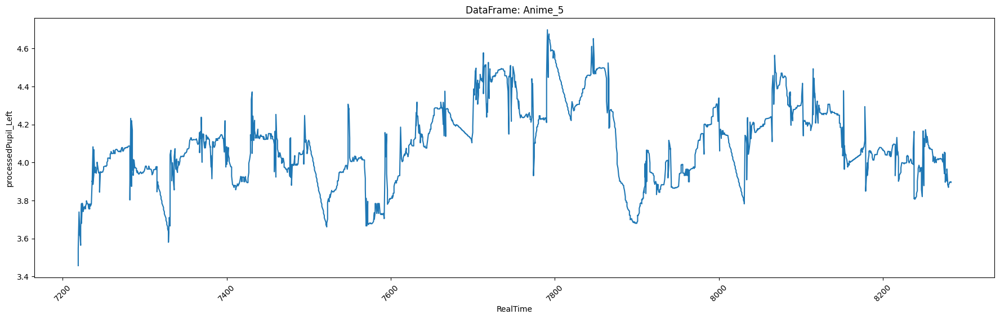

DataFrame: Anime_5
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



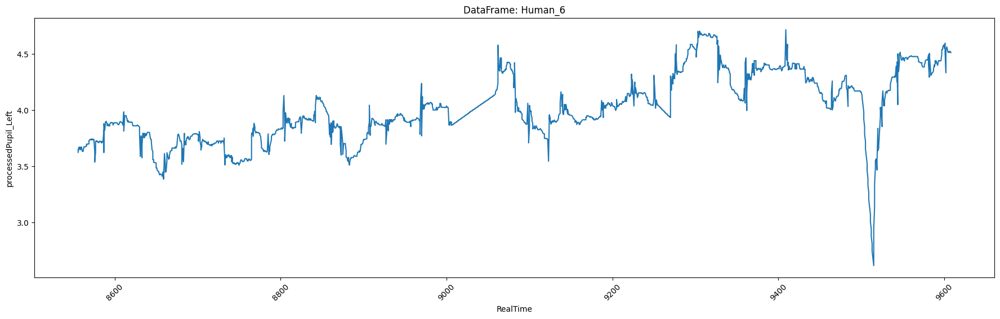

DataFrame: Human_6
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



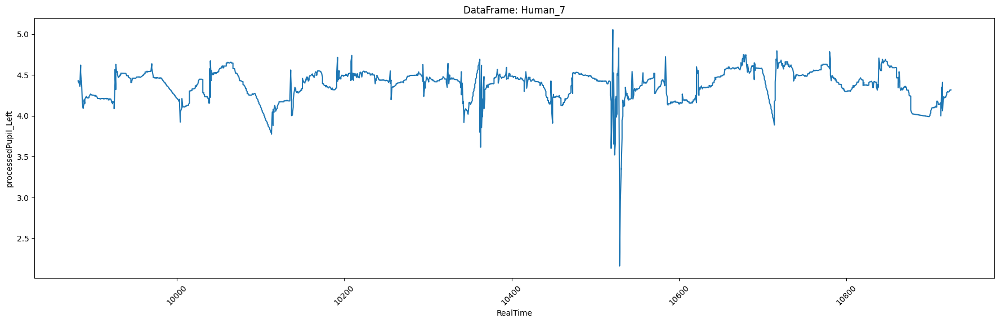

DataFrame: Human_7
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



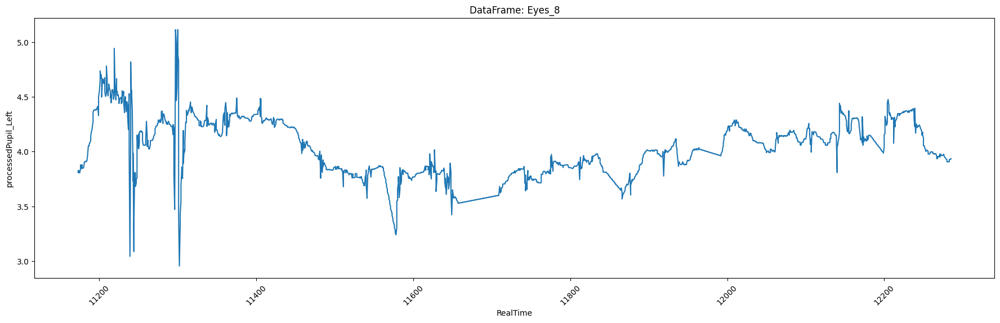

DataFrame: Eyes_8
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



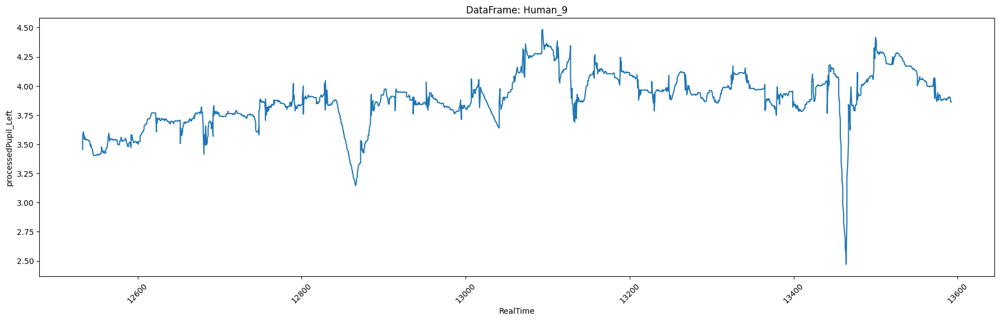

DataFrame: Human_9
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



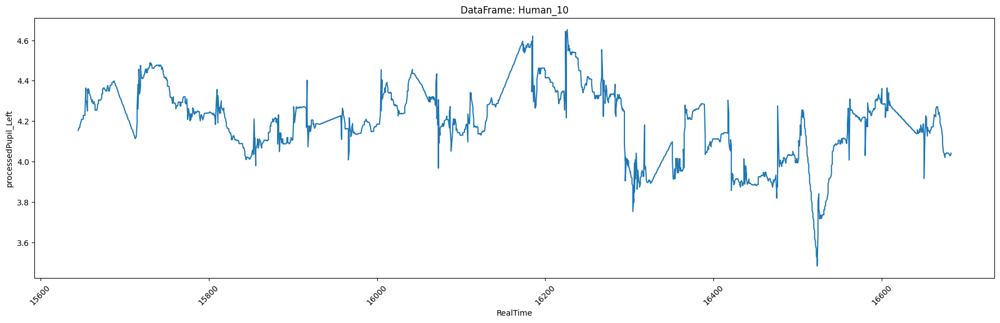

DataFrame: Human_10
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



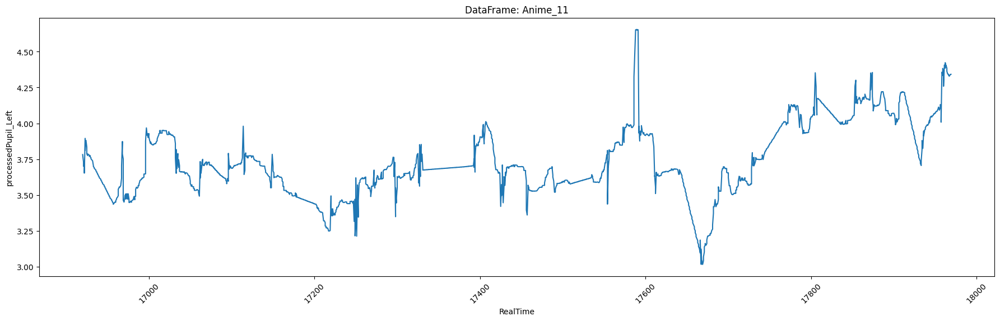

DataFrame: Anime_11
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



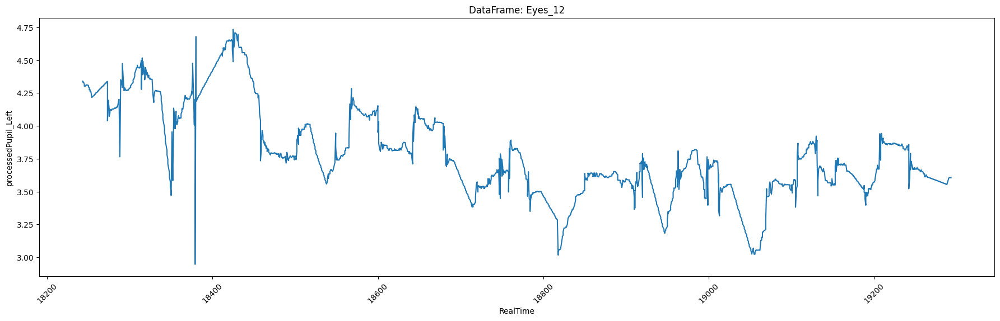

DataFrame: Eyes_12
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



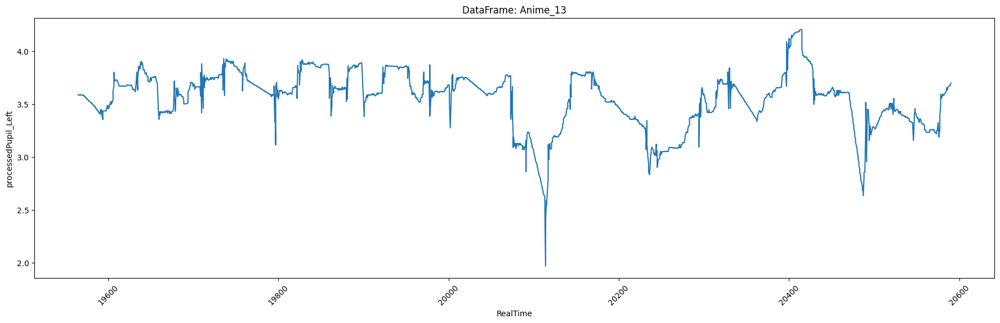

DataFrame: Anime_13
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



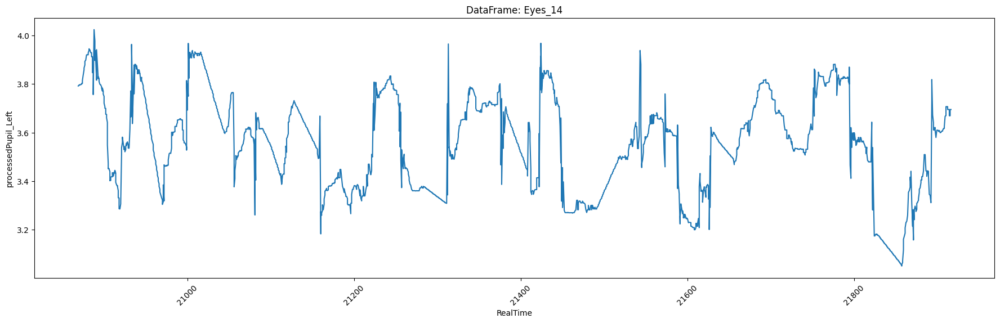

DataFrame: Eyes_14
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



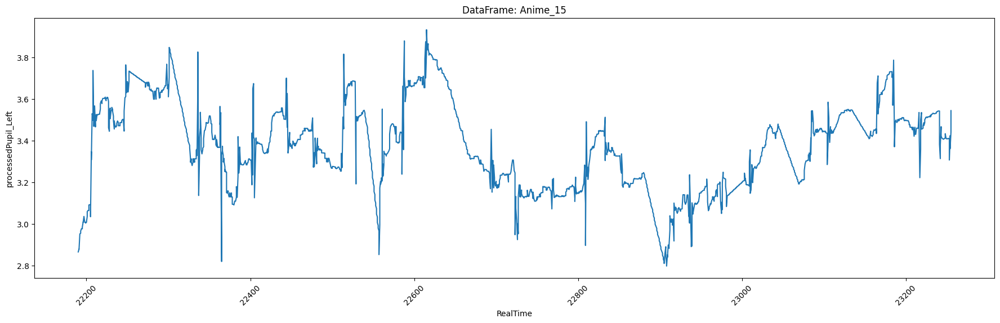

DataFrame: Anime_15
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



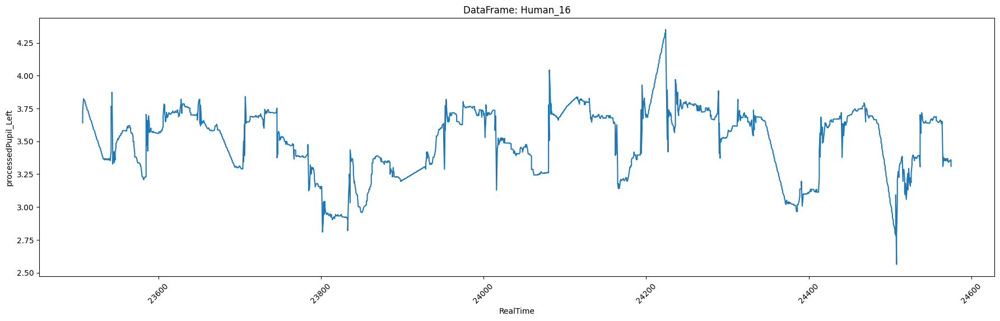

DataFrame: Human_16
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



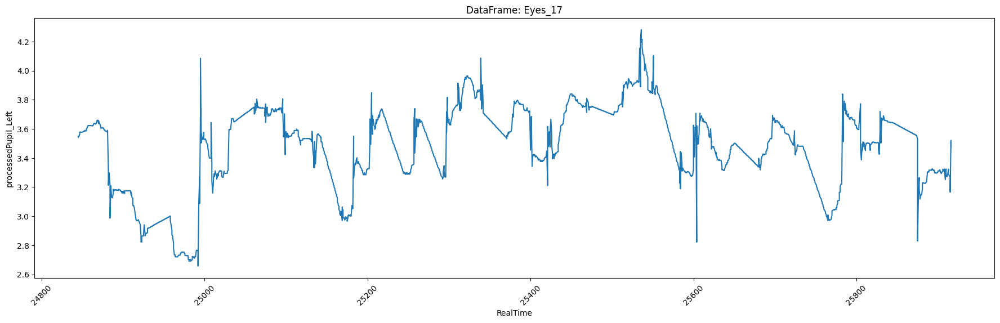

DataFrame: Eyes_17
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



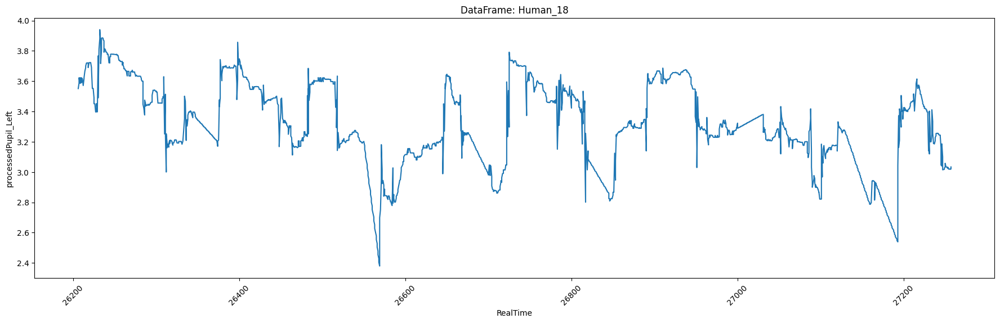

DataFrame: Human_18
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



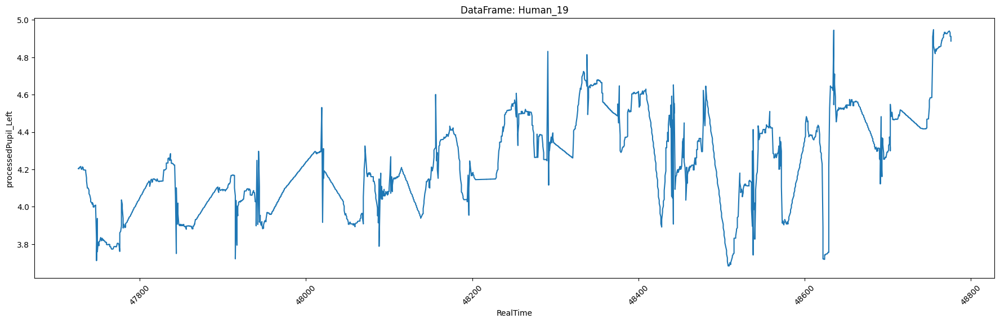

DataFrame: Human_19
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



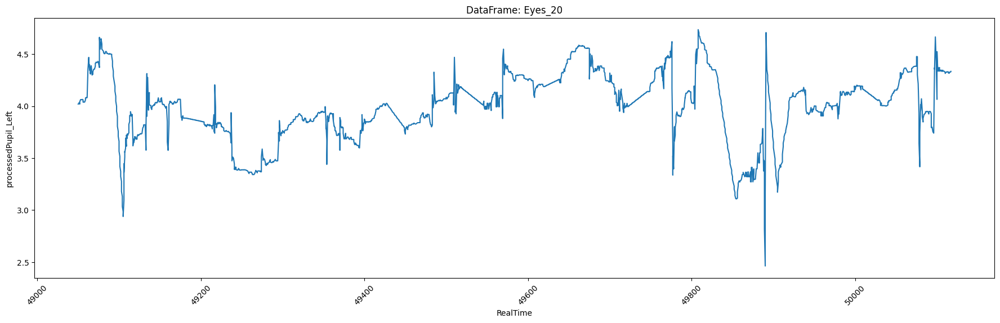

DataFrame: Eyes_20
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



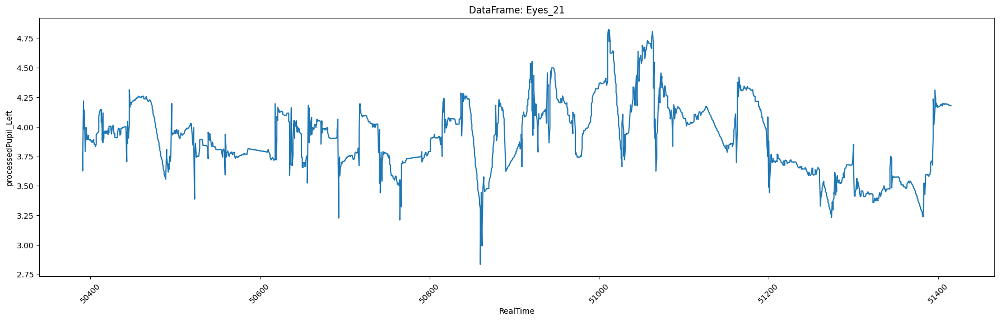

DataFrame: Eyes_21
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



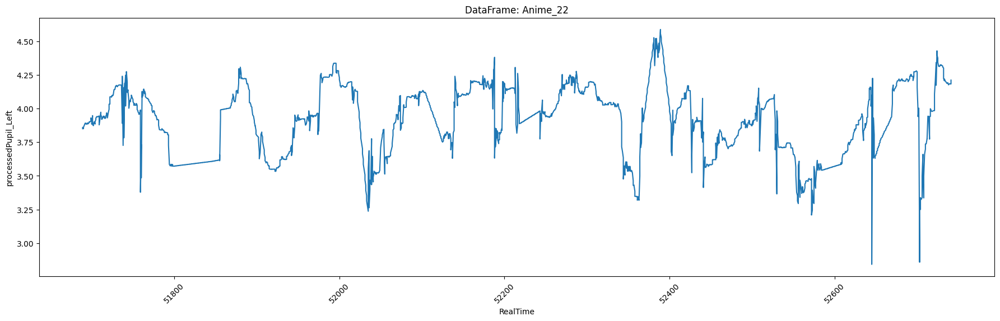

DataFrame: Anime_22
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



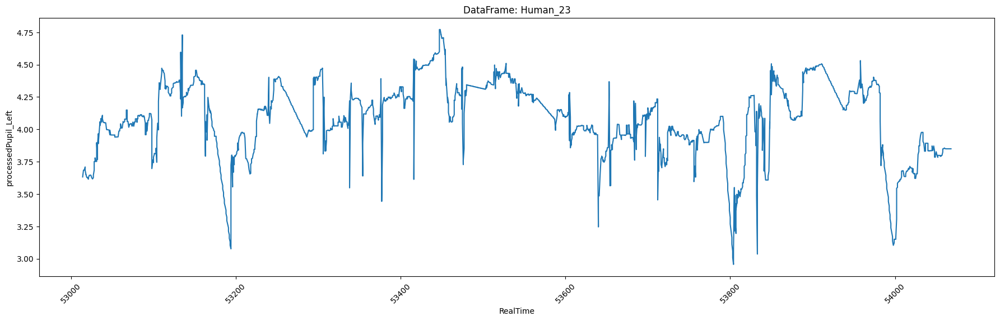

DataFrame: Human_23
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



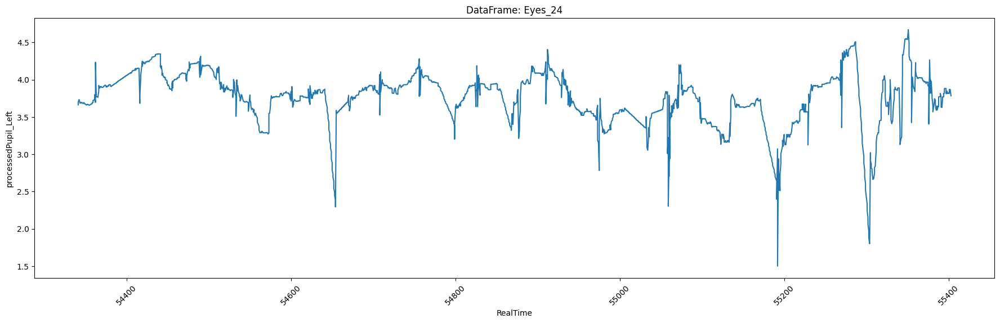

DataFrame: Eyes_24
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



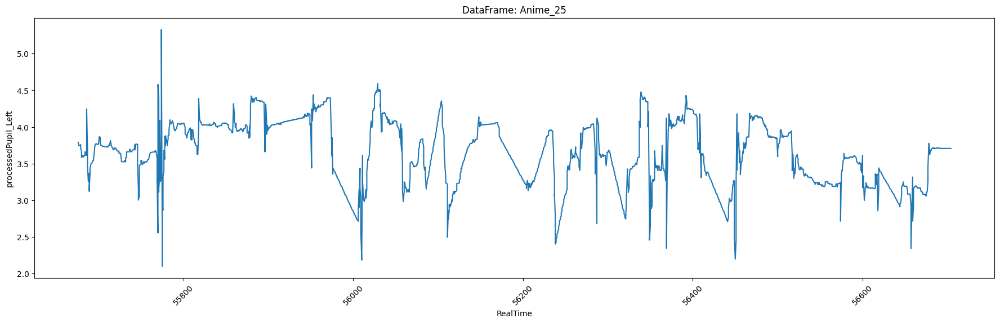

DataFrame: Anime_25
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



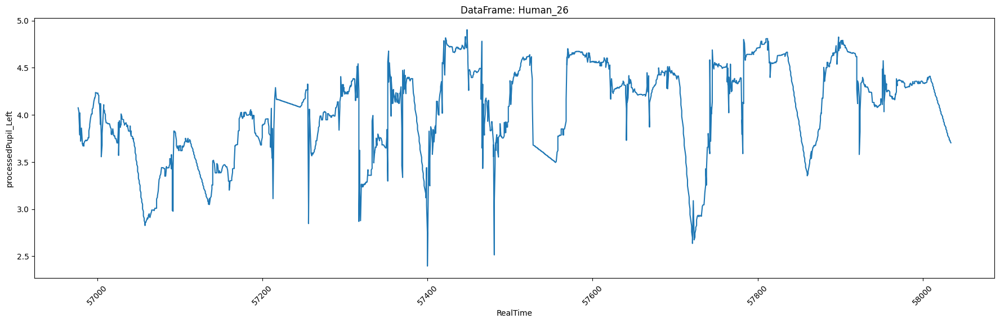

DataFrame: Human_26
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



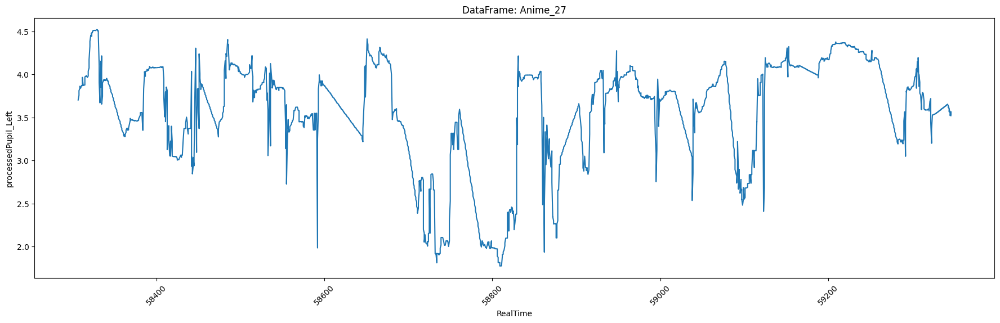

DataFrame: Anime_27
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



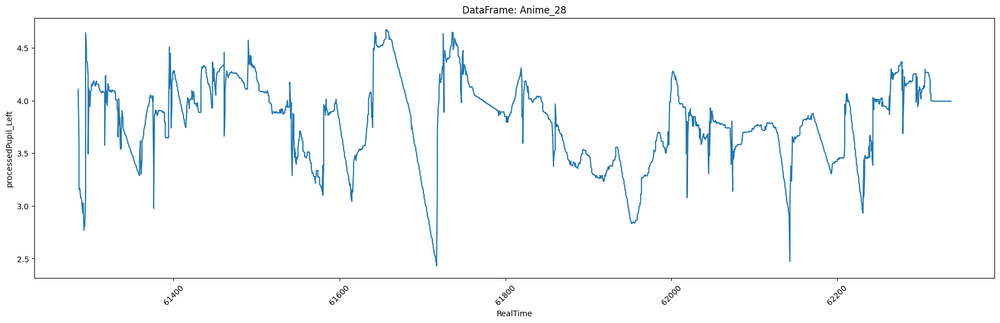

DataFrame: Anime_28
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



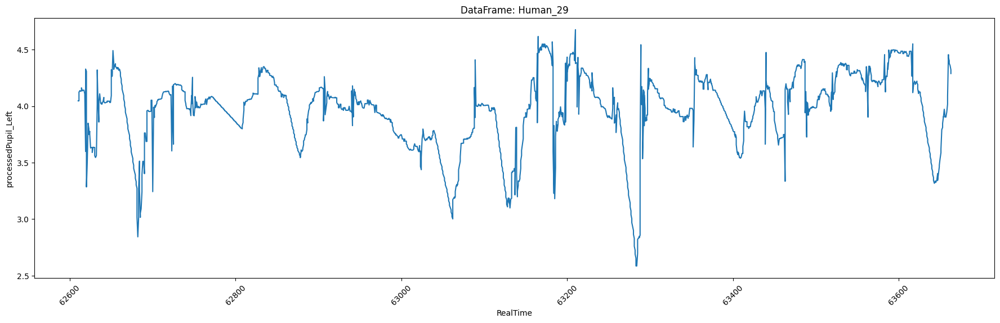

DataFrame: Human_29
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



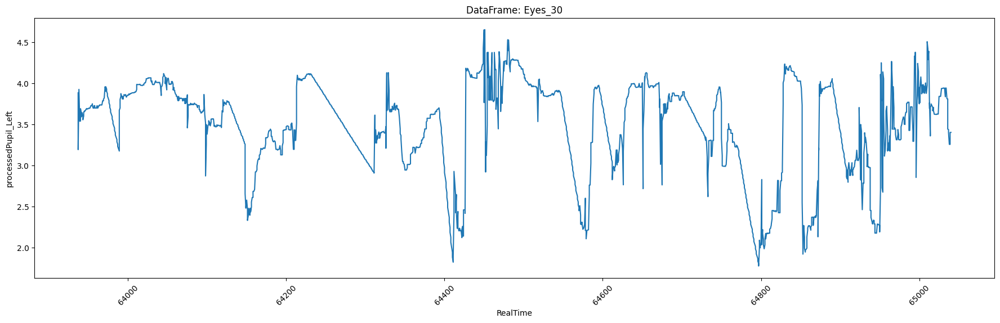

DataFrame: Eyes_30
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



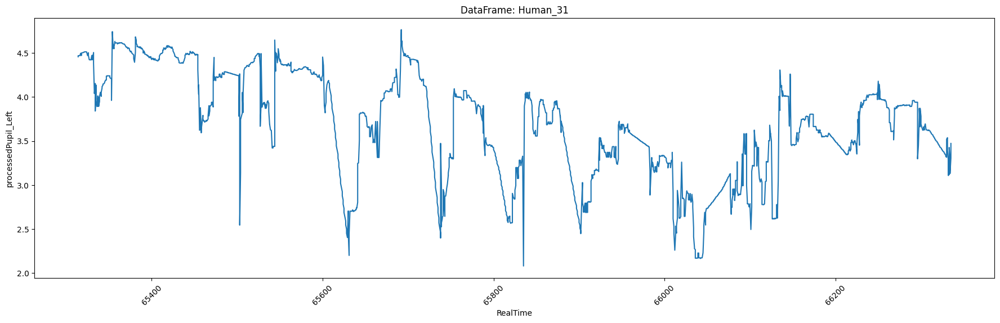

DataFrame: Human_31
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



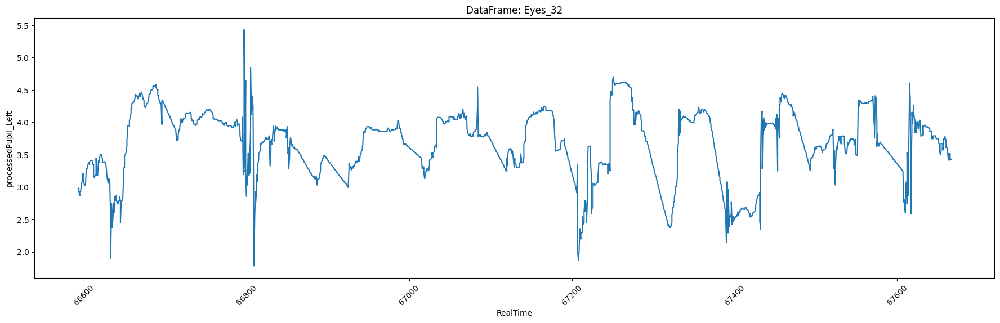

DataFrame: Eyes_32
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



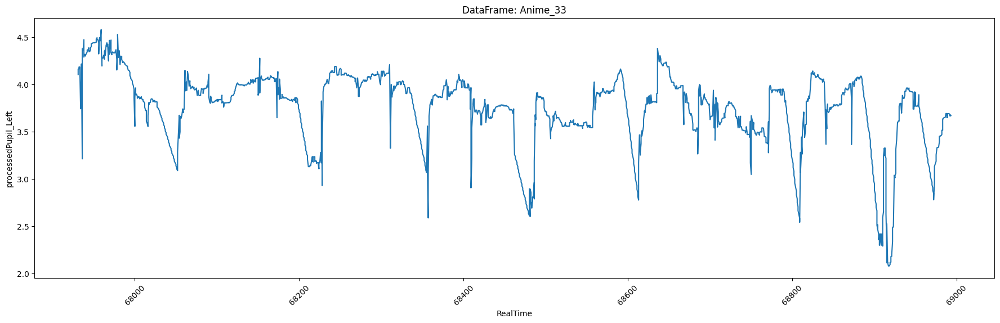

DataFrame: Anime_33
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



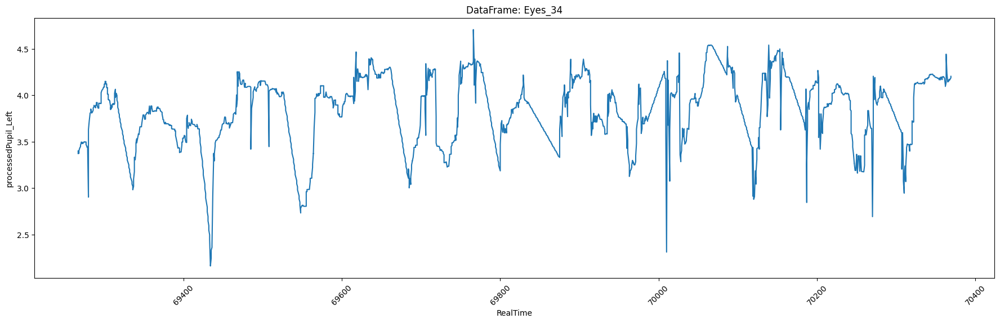

DataFrame: Eyes_34
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



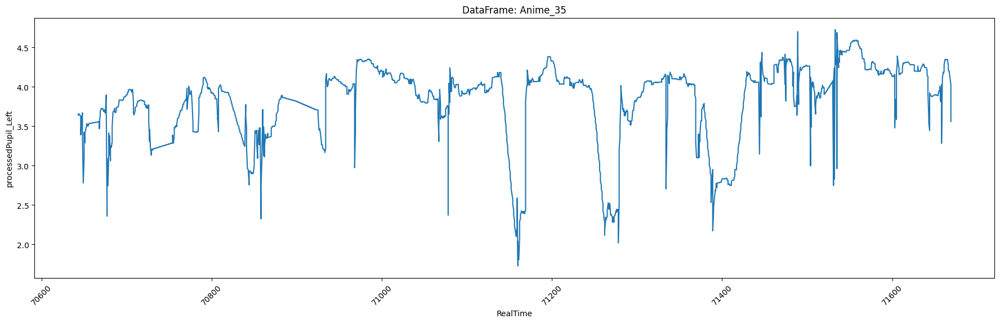

DataFrame: Anime_35
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



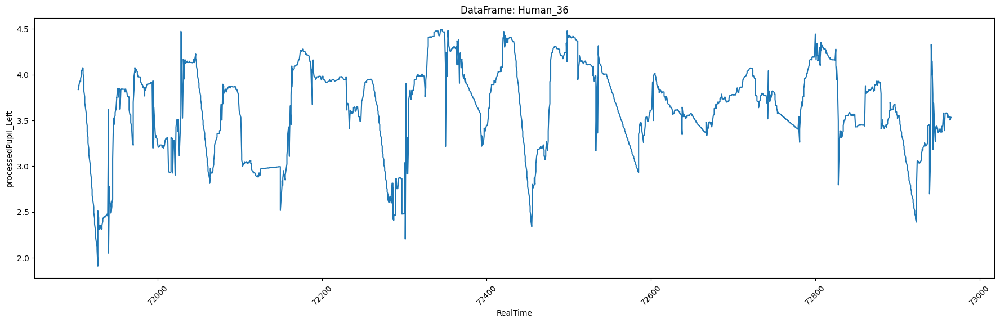

DataFrame: Human_36
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



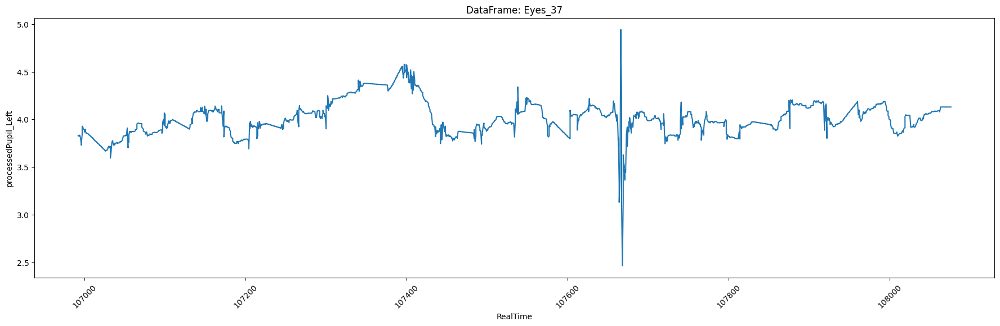

DataFrame: Eyes_37
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



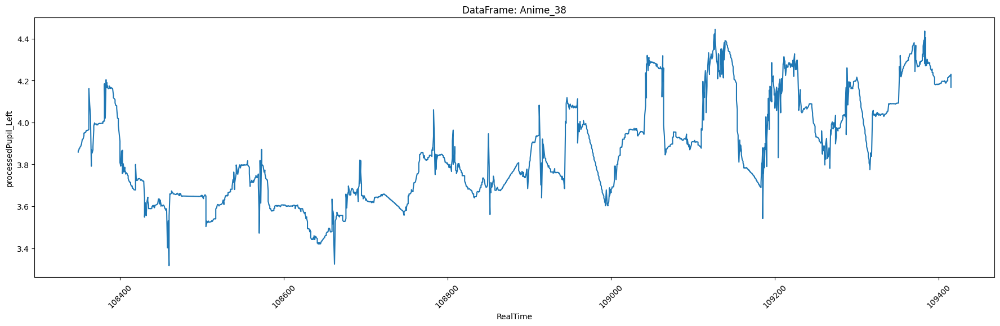

DataFrame: Anime_38
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



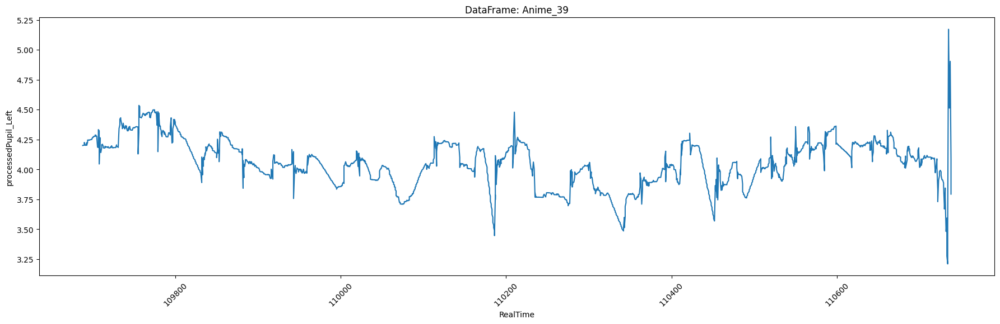

DataFrame: Anime_39
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



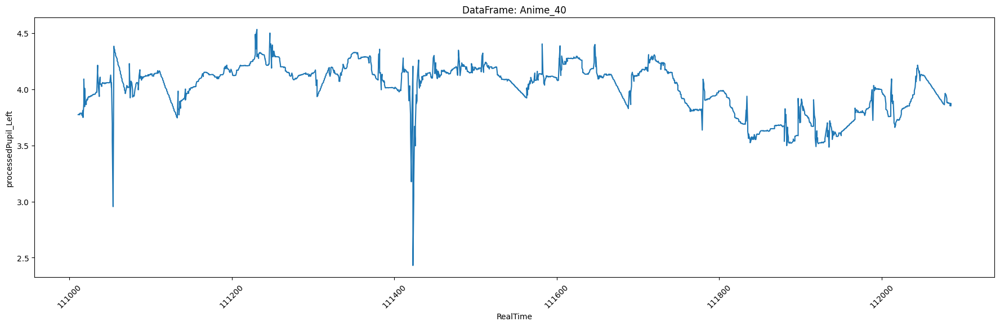

DataFrame: Anime_40
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



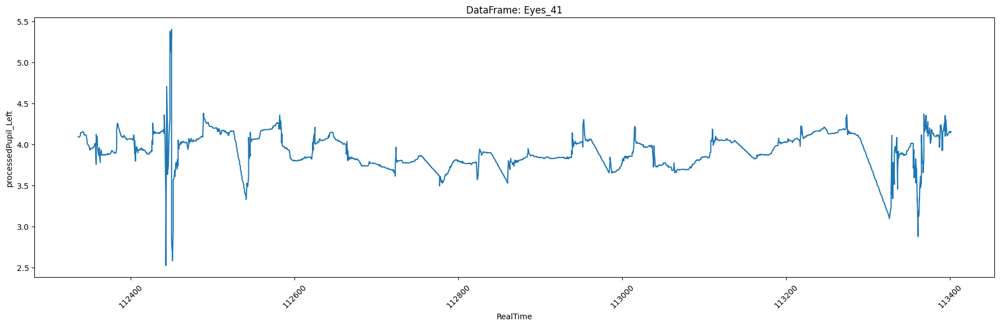

DataFrame: Eyes_41
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



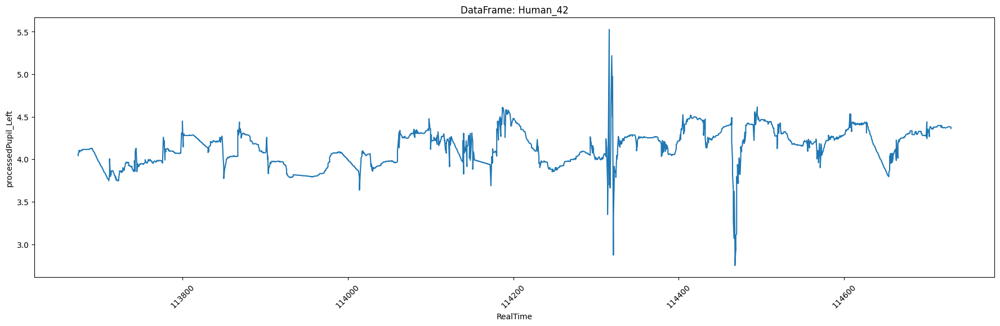

DataFrame: Human_42
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



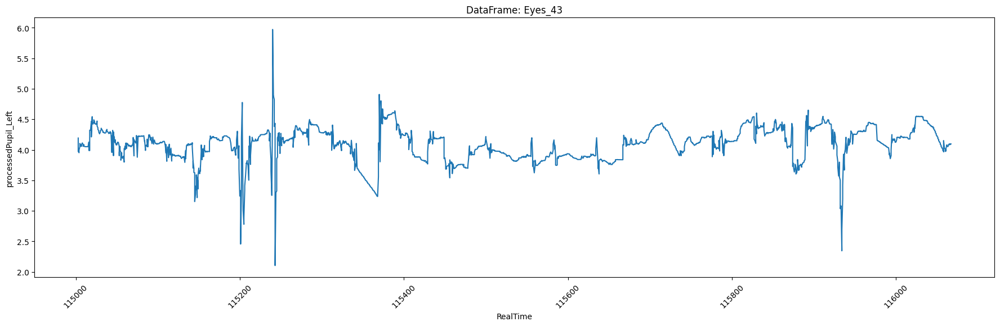

DataFrame: Eyes_43
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



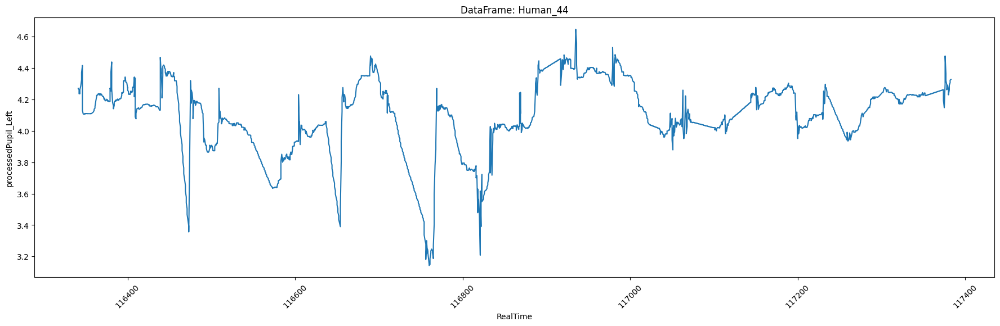

DataFrame: Human_44
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



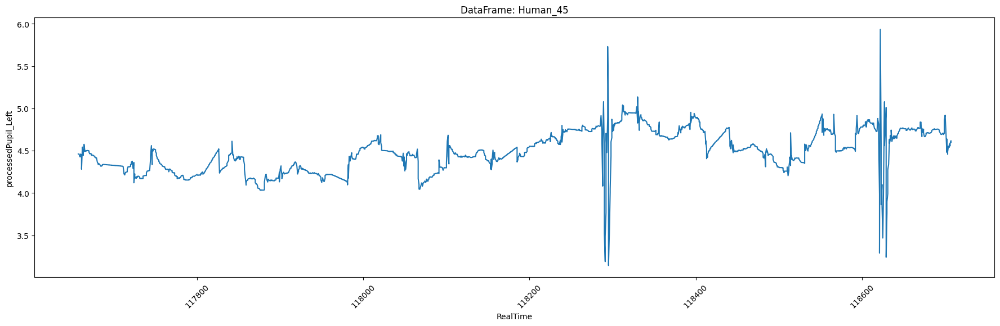

DataFrame: Human_45
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



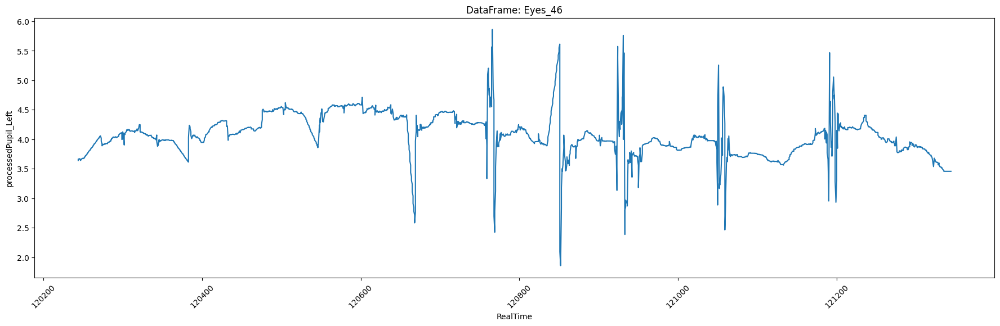

DataFrame: Eyes_46
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



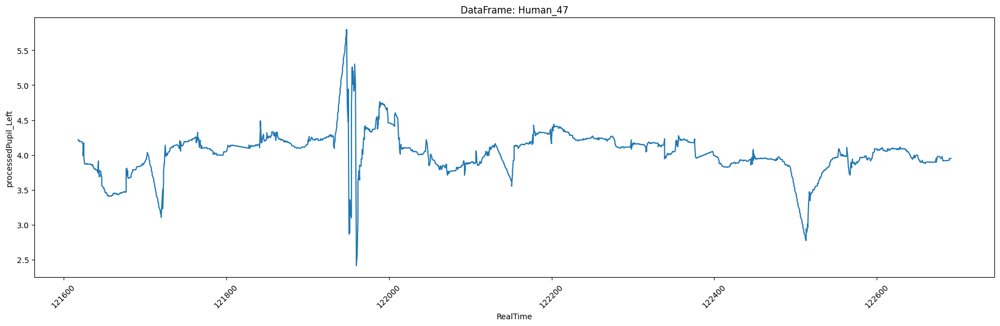

DataFrame: Human_47
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



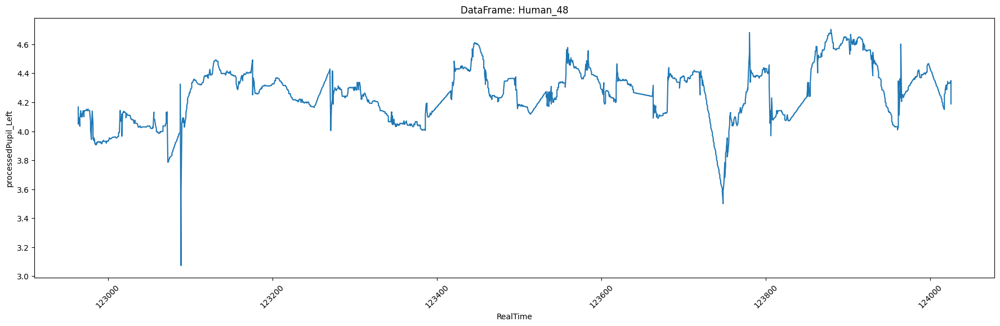

DataFrame: Human_48
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



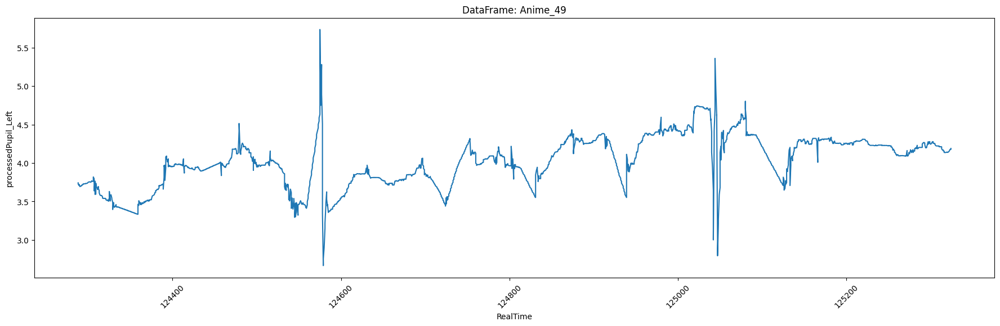

DataFrame: Anime_49
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



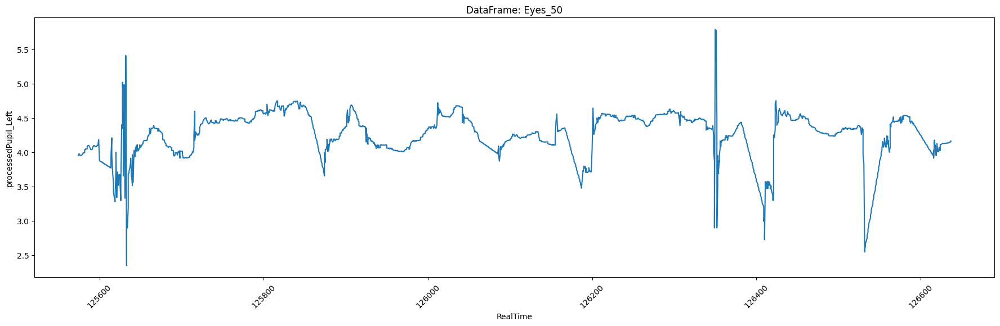

DataFrame: Eyes_50
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



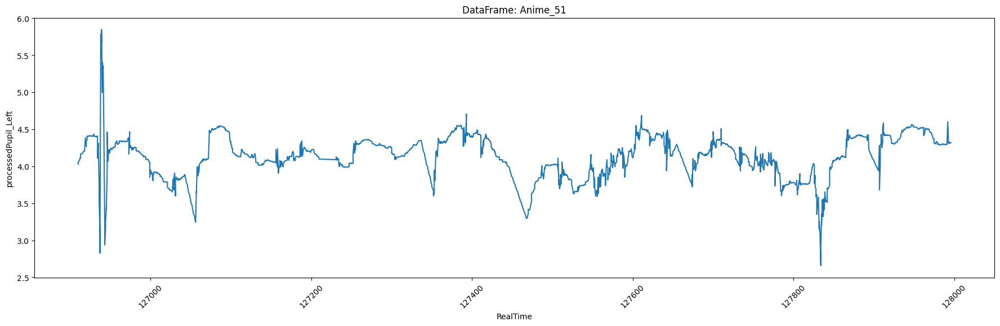

DataFrame: Anime_51
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



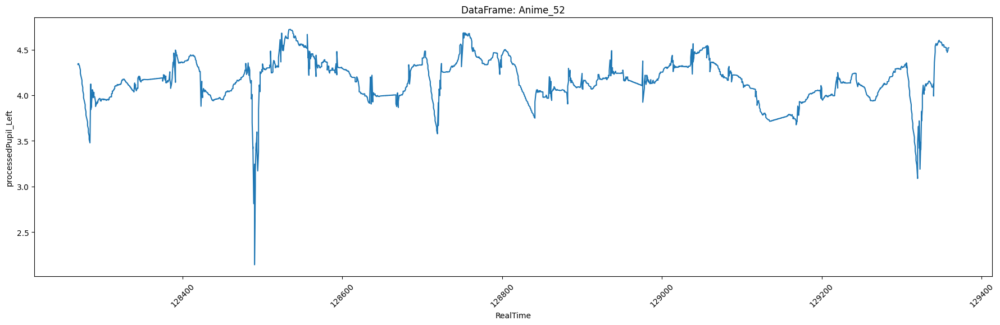

DataFrame: Anime_52
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



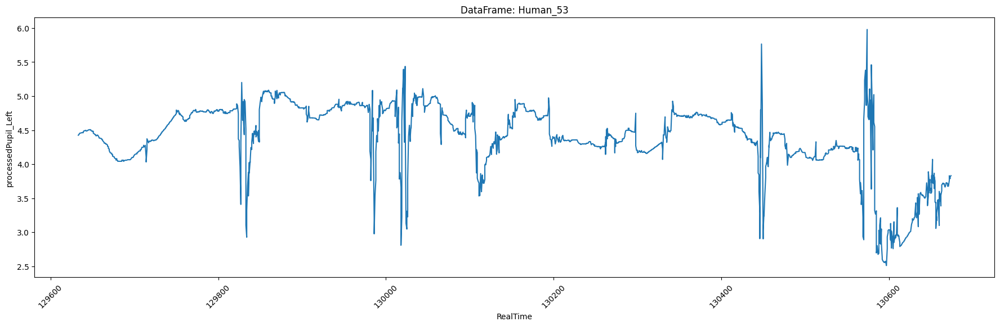

DataFrame: Human_53
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



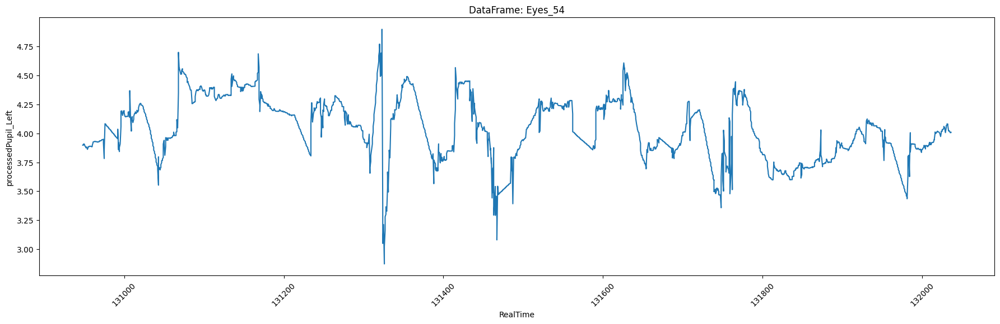

DataFrame: Eyes_54
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



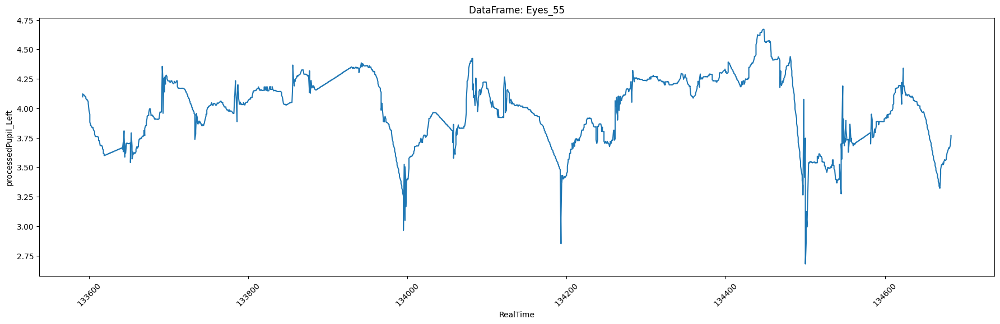

DataFrame: Eyes_55
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



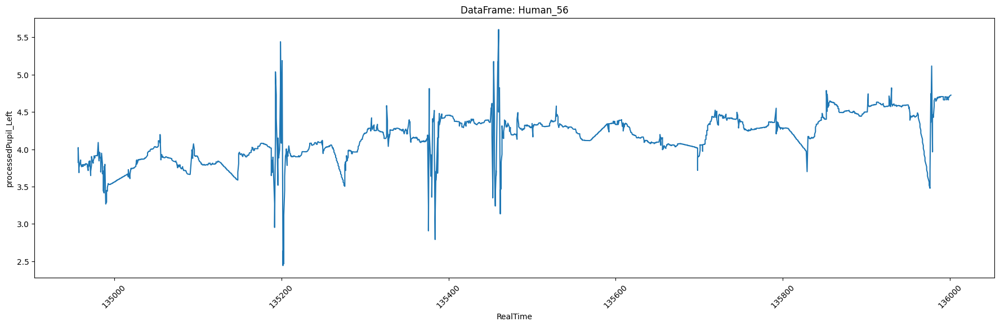

DataFrame: Human_56
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



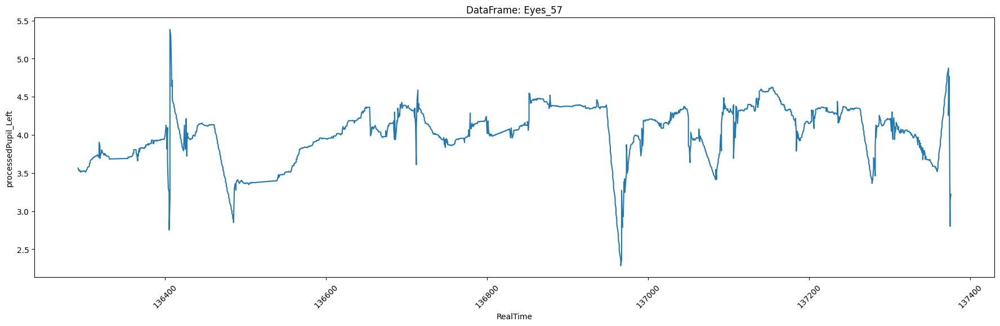

DataFrame: Eyes_57
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



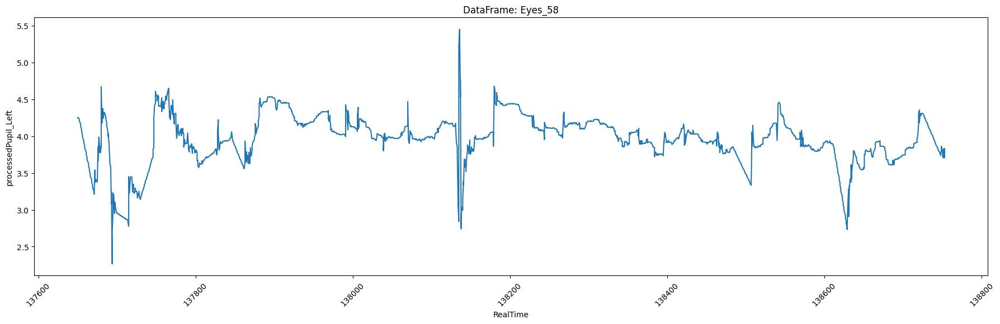

DataFrame: Eyes_58
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



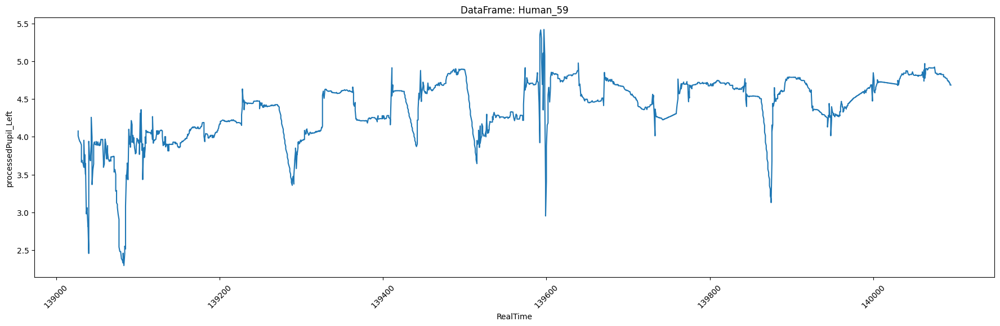

DataFrame: Human_59
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



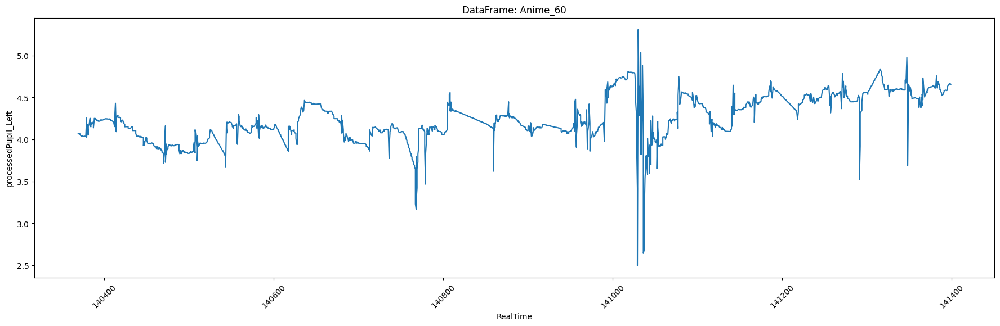

DataFrame: Anime_60
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



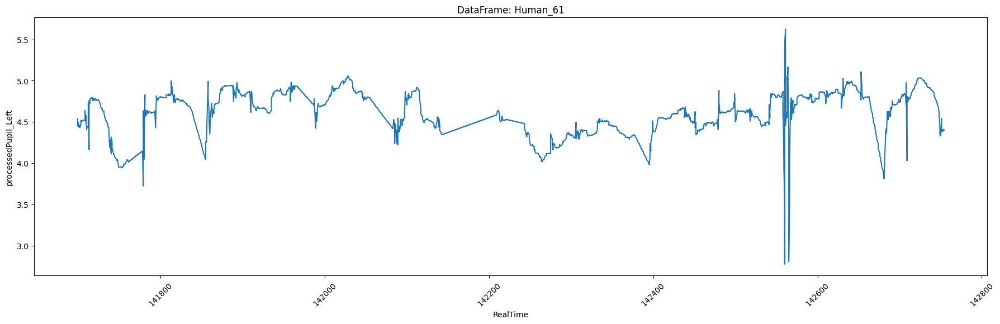

DataFrame: Human_61
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



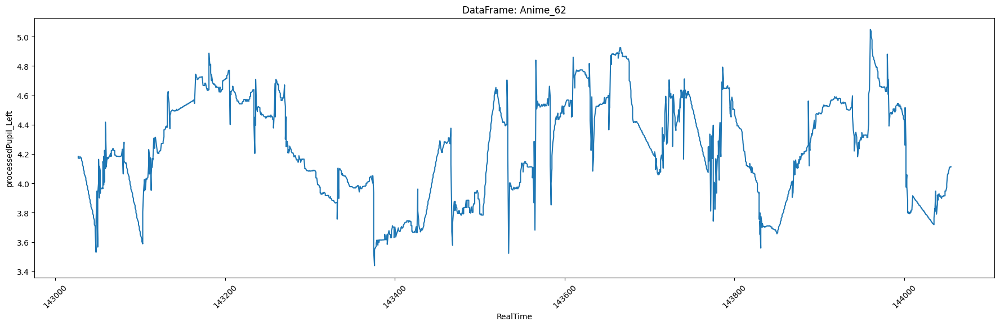

DataFrame: Anime_62
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



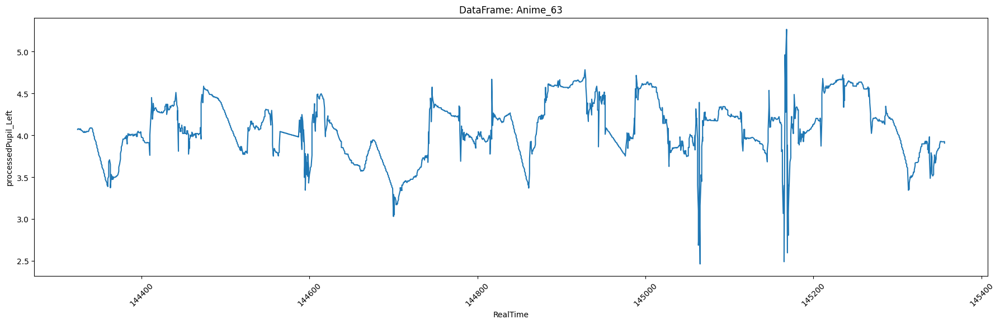

DataFrame: Anime_63
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



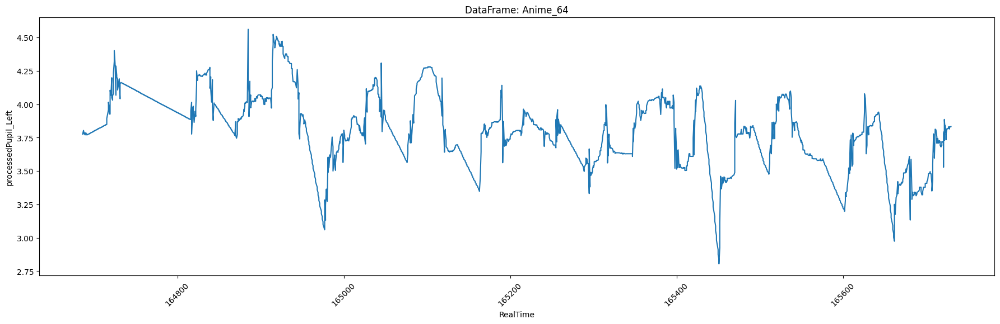

DataFrame: Anime_64
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



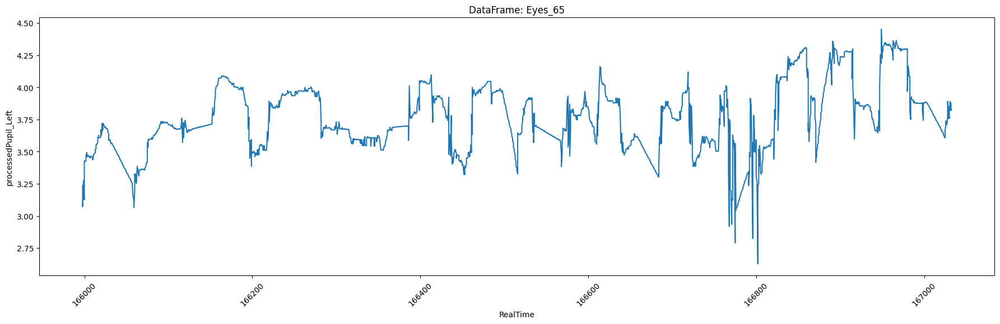

DataFrame: Eyes_65
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



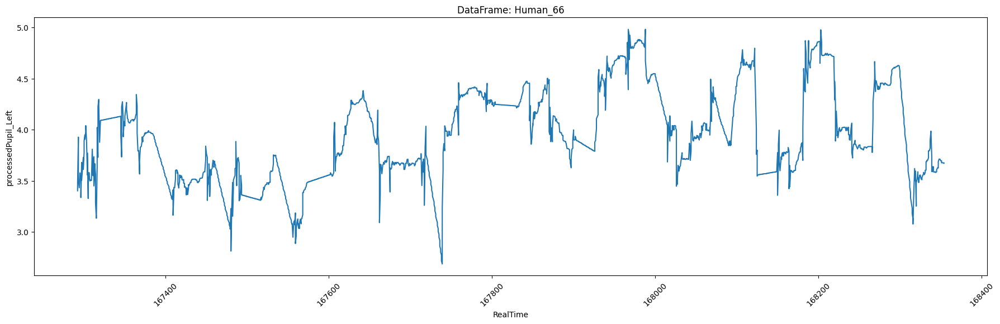

DataFrame: Human_66
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



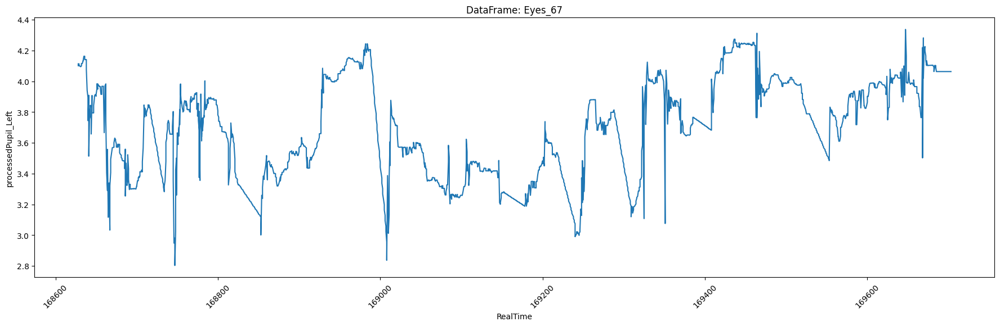

DataFrame: Eyes_67
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



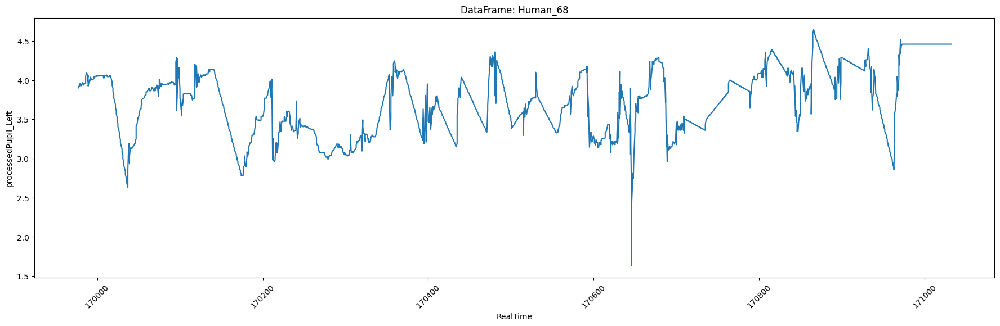

DataFrame: Human_68
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



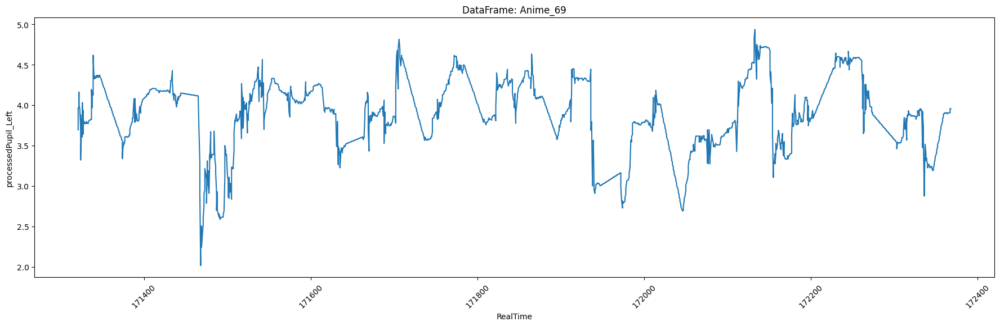

DataFrame: Anime_69
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



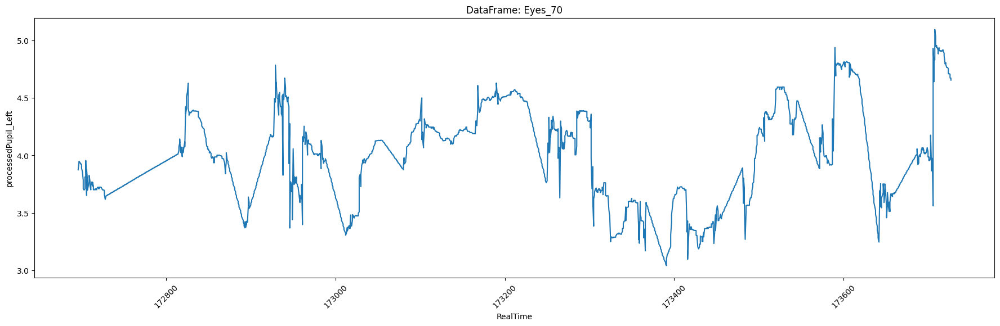

DataFrame: Eyes_70
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



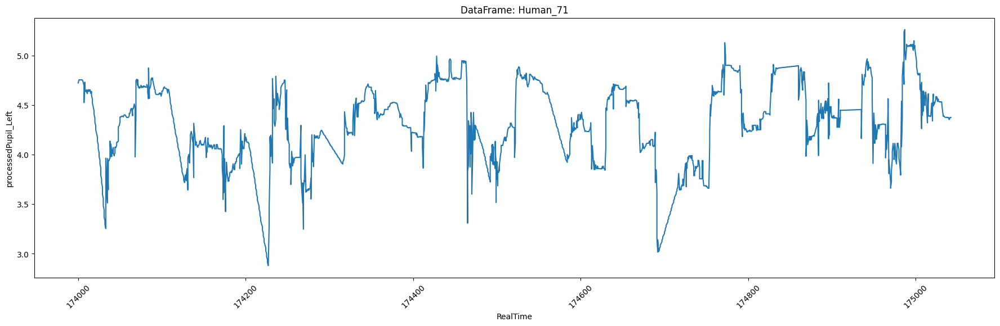

DataFrame: Human_71
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



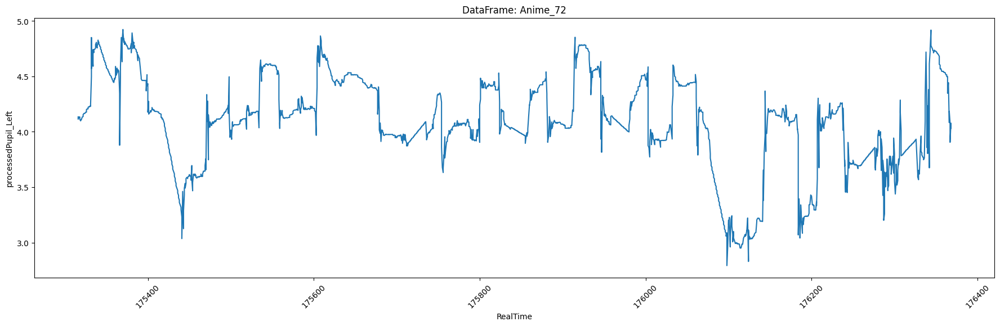

DataFrame: Anime_72
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



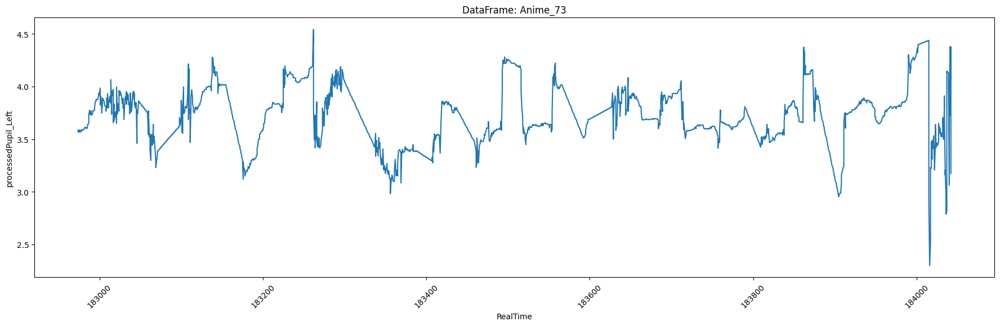

DataFrame: Anime_73
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



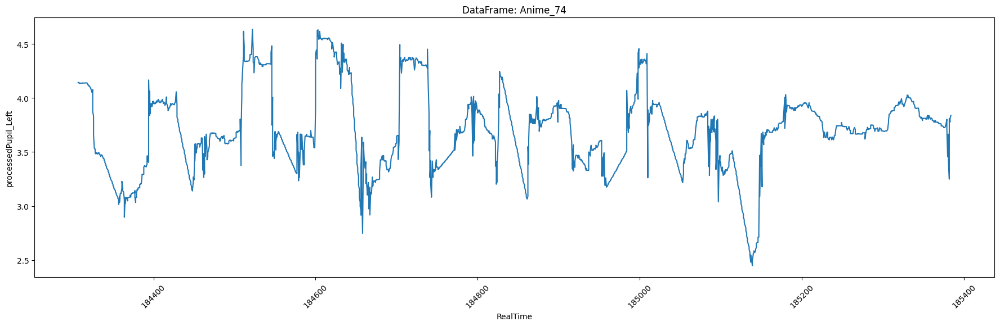

DataFrame: Anime_74
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



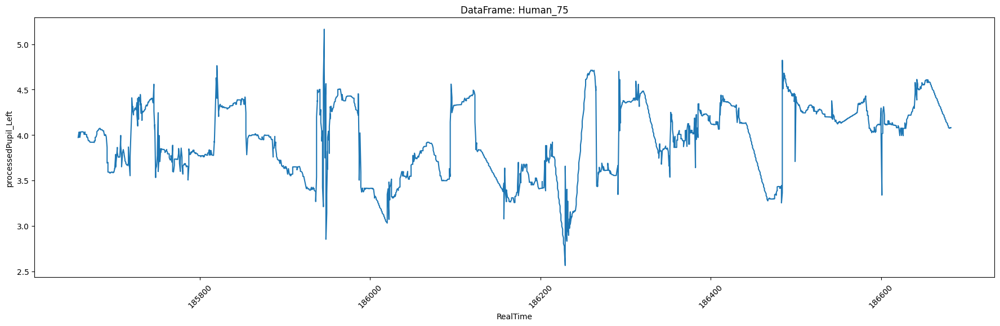

DataFrame: Human_75
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



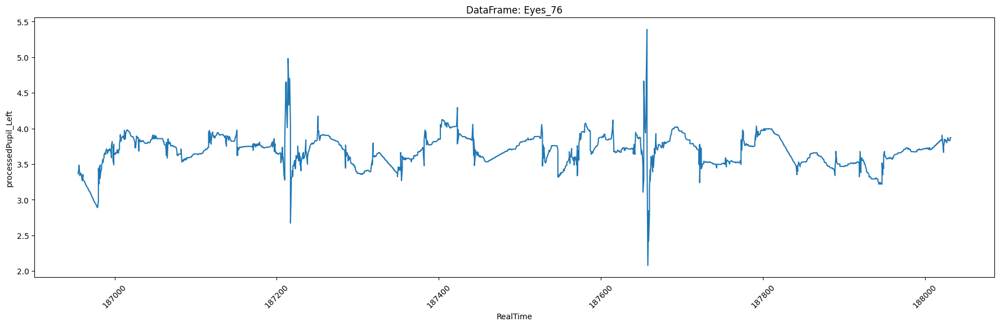

DataFrame: Eyes_76
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



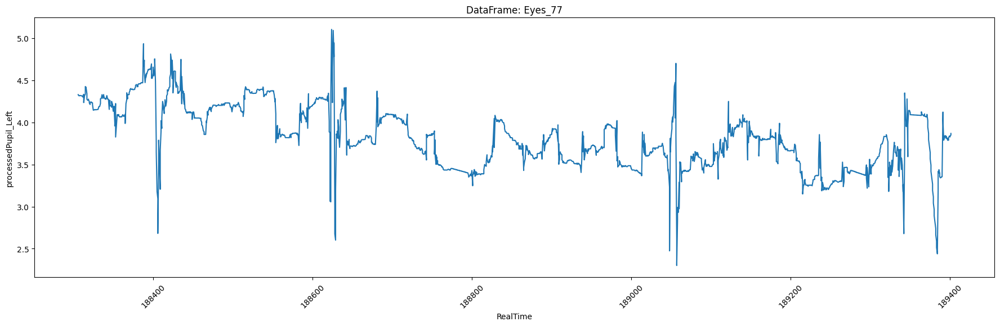

DataFrame: Eyes_77
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



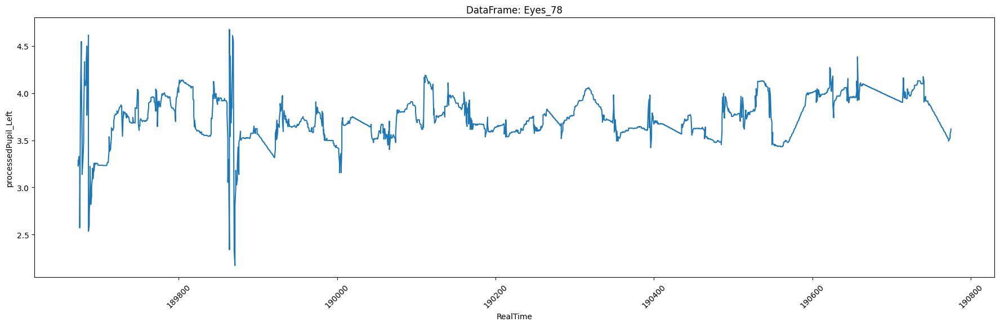

DataFrame: Eyes_78
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



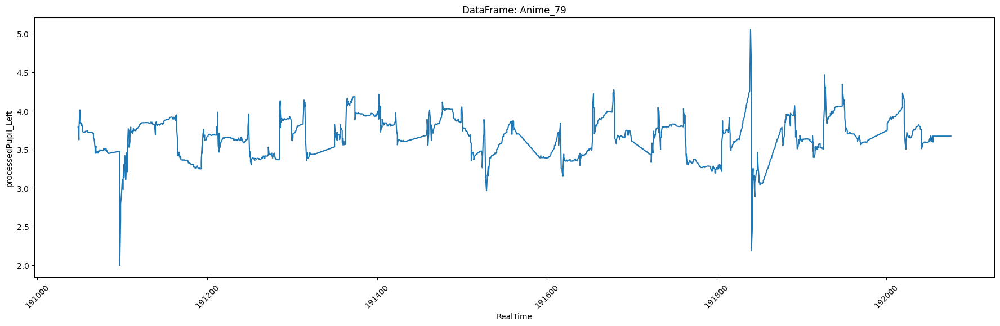

DataFrame: Anime_79
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



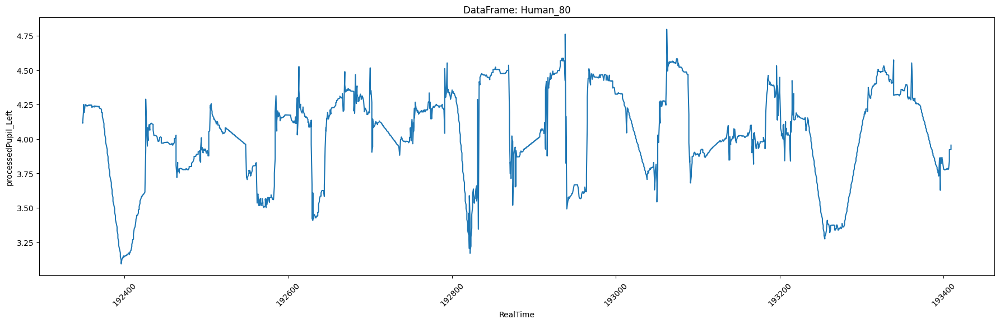

DataFrame: Human_80
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



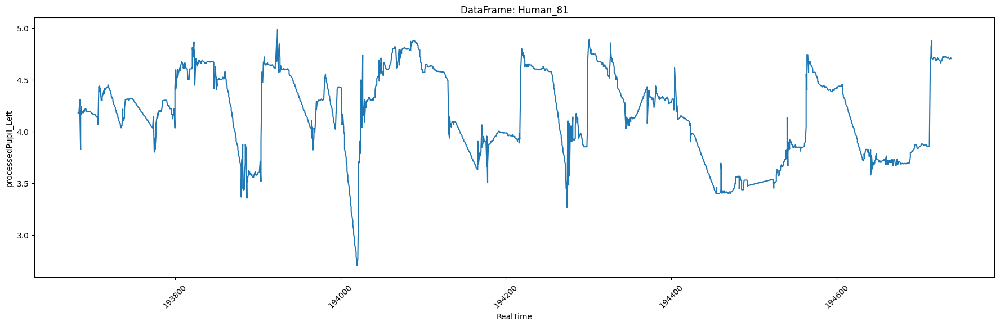

DataFrame: Human_81
Empty DataFrame
Columns: [Time, timestamp, gazeOrigin_L.X, gazeOrigin_L.Y, gazeOrigin_L.Z, gazeOrigin_R.X, gazeOrigin_R.Y, gazeOrigin_R.Z, gazeDir_L.X, gazeDir_L.Y, gazeDir_L.Z, gazeDir_R.X, gazeDir_R.Y, gazeDir_R.Z, pupilDia_L, pupilDia_R, eyeOpenness_L, eyeOpenness_R, pupilPosL.X, pupilPosL.Y, pupilPosR.X, pupilPosR.Y, Participant, UnityTime, CurrentSession, ConstrictedSize, DilatedSize, CurrentStimuli, StimuliStartSize, StimuliEndSize, StimuliPupilSize, PupilSizeChanging, PupilDataActive, LeftPupilSize, RightPupilSize, AveragePupilSize, RealTime, processedPupil_Left]
Index: []

[0 rows x 38 columns]



In [204]:
# Iterate over the test_dataframes dictionary
for name, currentTestdf in test_dataframes.items():
    currentTestdf = currentTestdf.copy()  # Create a copy of the dataframe
    currentTestdf['RealTime'] = pd.to_datetime(currentTestdf['RealTime'], unit='ms')  # Specify the unit as milliseconds
    currentTestdf = currentTestdf.set_index('frame').sort_index()
    plt.figure(figsize=(22, 6))
    plt.plot(currentTestdf.index, currentTestdf['processedPupil_Left'])
    plt.title(f"DataFrame: {name}")
    plt.xlabel("RealTime")
    plt.ylabel("processedPupil_Left")
    plt.xticks(rotation=45)
    plt.show()
    rows_with_negative_ones = currentTestdf[currentTestdf['processedPupil_Left'] == -1]
    print(f"DataFrame: {name}")
    print(rows_with_negative_ones)
    print()



In [205]:
# Specify the dataframe name
dataframe_name = "Eyes_2"

# Retrieve the dataframe based on the name
dataframe = test_dataframes[dataframe_name]

# Convert 'RealTime' column to datetime
dataframe['RealTime'] = pd.to_datetime(dataframe['RealTime'], unit='ms')

# Set the index of the dataframe
dataframe = dataframe.set_index('frame').sort_index()

data_table.DataTable(dataframe[['processedPupil_Left']] != -1)


,processedPupil_Left
frame,
3281,True
3282,True
3282,True
3283,True
3283,True
...,...
4345,True
4346,True
4346,True


## Split each test on num_splits Intervals so I can perform interpolation

In [ ]:
import datetime

# Define the number of splits
num_splits = 16

# Dictionary to store the split dataframes
split_dataframes = {}

# Iterate over the test_dataframes dictionary
for name, testDataFrame in test_dataframes.items():
    testDataFrame['RealTime'] = pd.to_datetime(testDataFrame['RealTime'], unit='ms')  # Convert RealTime to datetime
    # Calculate the time duration and interval length
    total_time = testDataFrame['RealTime'].iloc[-1] - testDataFrame['RealTime'].iloc[0]
    interval_length = total_time / num_splits

    # Find the start time and end time of each interval
    start_time = testDataFrame['RealTime'].iloc[0]
    end_time = start_time + interval_length
    interval_dataframes = []  # List to store the dataframes for each interval

    # Iterate over each row and split into separate dataframes
    for idx, row in testDataFrame.iterrows():
        if row['RealTime'] < end_time:
            interval_dataframes.append(row.to_frame().transpose())
        else:
            # Create a new dataframe for the next interval
            split_dataframes.setdefault(name, []).append(pd.concat(interval_dataframes, ignore_index=True))
            interval_dataframes = [row.to_frame().transpose()]
            start_time = end_time
            end_time = start_time + interval_length

    # Append the last interval dataframe
    split_dataframes.setdefault(name, []).append(pd.concat(interval_dataframes, ignore_index=True))

    # If the last interval is shorter than the other intervals, merge it with the previous interval
    if len(split_dataframes[name]) > 1 and len(split_dataframes[name][-1]) < len(split_dataframes[name][-2]):
        split_dataframes[name][-2] = pd.concat([split_dataframes[name][-2], split_dataframes[name][-1]], ignore_index=True)
        split_dataframes[name].pop()

# Print the split dataframes
for name, dfs in split_dataframes.items():
    print(f"DataFrame: {name}")
    for i, df in enumerate(dfs):
        print(f"Interval {i+1}")
        print()


#### How to interact with each interval

In [178]:
# Assuming you have a specific dataframe name and interval index
dataframe_name = "Anime_3"
interval_index = 6

# Retrieve the list of intervals for the specified dataframe
intervals = split_dataframes[dataframe_name]

# Access the specific interval using the index
specific_interval = intervals[interval_index]

# Print the 'pupilDia_L' and 'frame' columns of the specific interval
print(specific_interval[['processedPupil_Left','pupilDia_L', 'frame']])


    processedPupil_Left pupilDia_L frame
0              3.949524   3.949524  5007
1              3.936203   3.936203  5007
2              3.814026   3.814026  5008
3              3.739212   3.739212  5009
4              4.084824   4.084824  5009
..                  ...        ...   ...
115            3.899292   3.899292  5072
116            3.891708   3.891708  5073
117            3.891586   3.891586  5074
118            3.854385   3.854385  5074
119            3.845322   3.845322  5075

[120 rows x 3 columns]


### Remove and interpolate spikes

#### First remove all the columns we don't care about

In [179]:
# Print the split dataframes
for name, dfs in split_dataframes.items():
    # List of columns to keep
    columns_to_keep = ['RealTime', 'CurrentSession', 'CurrentStimuli', 'StimuliPupilSize', 'processedPupil_Left']

    # Iterate over the individual DataFrames in dfs
    for i, df in enumerate(dfs):
        # Remove columns not in the list
        df = df[columns_to_keep]

        # Display the DataFrame using DataTable
        data_table.DataTable(df)


### Calculate the speed of change

In [180]:
import matplotlib.pyplot as plt
from google.colab import data_table

# Iterate over the split dataframes
for name, dfs in split_dataframes.items():
    # Iterate over the intervals within each dataframe
    for i, df in enumerate(dfs):
        # Convert 'RealTime' to datetime if it's not already in datetime format
        df['RealTime'] = pd.to_datetime(df['RealTime'], unit='ms')

        # Sort the DataFrame by 'RealTime' in ascending order
        df = df.sort_values('RealTime')

        # Calculate the time difference between consecutive data points
        time_diff = df['RealTime'].diff()

        # Calculate the difference in 'pupilDia_L' values
        diff_pupilDia_L = df['processedPupil_Left'].diff()

        print(time_diff.dt.total_seconds() * 10000)


        print(abs(diff_pupilDia_L))

        diff_pupilDia_L = abs(diff_pupilDia_L)
        time_diff = time_diff.dt.total_seconds() * 10000

        # Calculate the derivative of 'pupilDia_L' with respect to time
        speed_of_change = diff_pupilDia_L / time_diff

        print(speed_of_change)
        # Add the 'SpeedOfChange' column to the DataFrame
        df['SpeedOfChange'] = speed_of_change

        # Assign the updated DataFrame back to the intervals list
        dfs[i] = df


Streaming output truncated to the last 5000 lines.
4      0.08
       ... 
116    0.09
117    0.08
118    0.08
119    0.09
120    0.08
Name: RealTime, Length: 121, dtype: float64
0           NaN
1      0.003723
2      5.128113
3           0.0
4           0.0
         ...   
116    0.011398
117    0.032776
118    0.025788
119    0.002121
120    0.001648
Name: processedPupil_Left, Length: 121, dtype: object
0            NaN
1       0.046537
2      64.101412
3            0.0
4            0.0
         ...    
116     0.126644
117       0.4097
118      0.32235
119     0.023567
120       0.0206
Length: 121, dtype: object
0       NaN
1      0.09
2      0.08
3      0.08
4      0.09
       ... 
115    0.09
116    0.08
117    0.08
118    0.09
119    0.08
Name: RealTime, Length: 120, dtype: float64
0           NaN
1      0.025512
2      0.026245
3      0.002762
4      0.013947
         ...   
115    0.037261
116    0.055451
117    0.084167
118    0.144012
119    0.018692
Name: processedPupil_Left

### Calculate Acceleration

In [181]:
# Iterate over the split dataframes
for name, dfs in split_dataframes.items():
    print(f"DataFrame: {name}")
    # Iterate over the intervals within each dataframe
    for i, df in enumerate(dfs):
        print(f"Interval: {i+1}")

        # Calculate the time difference between consecutive data points
        time_diff = df['RealTime'].diff()

        # Calculate the speed difference between consecutive data points
        speed_diff = df['SpeedOfChange'].diff()

        time_diff = time_diff.dt.total_seconds() * 10000

        # Calculate the acceleration change
        acceleration_change = speed_diff / time_diff

        # Add the 'AccelerationChange' column to the DataFrame
        df['AccelerationChange'] = abs(acceleration_change)

        # Print the DataFrame with the added column
        print(df[['RealTime', 'processedPupil_Left', 'SpeedOfChange', 'AccelerationChange']])
        print()


Streaming output truncated to the last 5000 lines.
[121 rows x 4 columns]

Interval: 5
                      RealTime processedPupil_Left SpeedOfChange  \
0   1970-01-01 00:00:00.004016            3.972122           NaN   
1   1970-01-01 00:00:00.004024             3.97345        0.0166   
2   1970-01-01 00:00:00.004032            3.970551      0.036238   
3   1970-01-01 00:00:00.004041            3.970886      0.003722   
4   1970-01-01 00:00:00.004049            3.974915      0.050363   
..                         ...                 ...           ...   
115 1970-01-01 00:00:00.004974            4.507004      1.979263   
116 1970-01-01 00:00:00.004982            4.207397      3.745087   
117 1970-01-01 00:00:00.004991            4.191956      0.171567   
118 1970-01-01 00:00:00.004999            4.492859      3.761287   
119 1970-01-01 00:00:00.005007            4.522552      0.371162   

    AccelerationChange  
0                  NaN  
1                  NaN  
2             0.24546

In [182]:
# Iterate over the split dataframes
for name, dfs in split_dataframes.items():
    print(f"DataFrame: {name}")
    # Iterate over the intervals within each dataframe
    for i, df in enumerate(dfs):
        print(f"Interval: {i+1}")
        # Calculate the time difference between consecutive data points
        time_diff = df['RealTime'].diff()

        # Calculate the speed difference between consecutive data points
        speed_diff = df['SpeedOfChange'].diff()

        time_diff = time_diff.dt.total_seconds() * 10000

        # Calculate the acceleration change
        acceleration_change = speed_diff / time_diff

        # Calculate the difference between consecutive acceleration values
        acceleration_delta = acceleration_change.diff()

        # Add the 'AccelerationDelta' column to the DataFrame
        df['AccelerationDelta'] = acceleration_delta

        # Print the DataFrame with the added column
        print(df[['RealTime', 'pupilDia_L', 'SpeedOfChange', 'AccelerationChange', 'AccelerationDelta']])
        print()


Streaming output truncated to the last 5000 lines.
[121 rows x 5 columns]

Interval: 5
                      RealTime pupilDia_L SpeedOfChange AccelerationChange  \
0   1970-01-01 00:00:00.004016   3.972122           NaN                NaN   
1   1970-01-01 00:00:00.004024    3.97345        0.0166                NaN   
2   1970-01-01 00:00:00.004032   3.970551      0.036238           0.245469   
3   1970-01-01 00:00:00.004041   3.970886      0.003722           0.361281   
4   1970-01-01 00:00:00.004049   3.974915      0.050363           0.583003   
..                         ...        ...           ...                ...   
115 1970-01-01 00:00:00.004974   4.507004      1.979263           3.774809   
116 1970-01-01 00:00:00.004982   4.207397      3.745087          22.072812   
117 1970-01-01 00:00:00.004991   4.191956      0.171567          39.705787   
118 1970-01-01 00:00:00.004999   4.492859      3.761287           44.87151   
119 1970-01-01 00:00:00.005007   4.522552      0.371162

In [ ]:
import matplotlib.pyplot as plt
from google.colab import data_table
import csv

dataframe_name = "Eyes_8"
interval_index = 5

# Retrieve the list of intervals for the specified dataframe
intervals = split_dataframes[dataframe_name]

# Access the specific interval using the index
specific_interval = intervals[interval_index]

# Print the columns of the specific interval dataframe
print(specific_interval.columns)

print(specific_interval[['RealTime', 'pupilDia_L', 'SpeedOfChange', 'AccelerationChange', 'AccelerationDelta']])

# Export the specific interval DataFrame to a CSV file
specific_interval.to_csv('specific_interval.csv', index=False, quoting=csv.QUOTE_NONNUMERIC)

# Retrieve the list of intervals for the specified dataframe
intervals = split_dataframes[dataframe_name]

# Access the specific interval using the index
specific_interval = intervals[interval_index]

# Create a new DataFrame with only the 'SpeedOfChange' column
speed_df = specific_interval[['SpeedOfChange']]

# Plot 'RealTime' vs 'processedPupil_Left'
plt.figure(figsize=(22, 6))
plt.plot(specific_interval['RealTime'], specific_interval['processedPupil_Left'])
plt.xlabel('RealTime')
plt.ylabel('processedPupil_Left')
plt.title('RealTime vs processedPupil_Left')
plt.show()


### Create scaled stimuli pupil size column for each test

In [ ]:
# Iterate over the test_dataframes dictionary
for name, testDataFrame in test_dataframes.items():
    # Scale the StimuliPupilSize values within the range of ConstrictedSize and DilatedSize
    scaled_StimuliPupilSize = (testDataFrame['StimuliPupilSize'] * (testDataFrame['DilatedSize'] - testDataFrame['ConstrictedSize'])) + testDataFrame['ConstrictedSize']

    # Add the scaled values as a new column
    testDataFrame['ScaledStimuliPupilSize'] = scaled_StimuliPupilSize

    print(f"DataFrame: {name}")
    print(testDataFrame.columns)

##Interpolation Using PyPlr

In [ ]:
# Sampling frequency
SAMPLE_RATE = 60

# Create a separate plot for each session
for name, currentTestdf in dataframes.items():

    # Calculate the minimum value of 'ConstrictedSize'
    min_constricted_size = df['ConstrictedSize'].min()

    # Calculate the maximum value of 'DilatedSize'
    max_dilated_size = df['DilatedSize'].max()

    # Pupil columns to analyse
    pupil_cols = ['LeftPupilSize']
    processedValues = currentTestdf

    # Mask first derivative
    processedValues = preproc.mask_pupil_first_derivative(
        processedValues, threshold=3.0, mask_cols=pupil_cols)

    # Interpolate
    processedValues = preproc.interpolate_pupil(
        processedValues, interp_cols=pupil_cols)

    # Smooth
    processedValues = preproc.butterworth_series(
        processedValues, fields=pupil_cols, filt_order=3,
        cutoff_freq=4/(SAMPLE_RATE/2))

    plt.figure(figsize=(30, 6))  # Adjust the figsize parameter to your desired width and height

    # Overlay line chart for AveragePupilSize
    time_str = currentTestdf['Time'].dt.time.astype(str)
    plt.plot(time_str, currentTestdf['LeftPupilSize'], marker='o', linestyle='-', color='black', label='LeftPupilSize')

    # Scale values of StimuliPupilSize from 0 to 1 and then map them to the range of min_constricted_size to max_dilated_size
    scaled_values = (currentTestdf['StimuliPupilSize'] - 0) / (1 - 0) * (4.5 - 1.2) + 1.2

    # Bar chart for StimuliPupilSize with scaled values
    plt.bar(time_str, scaled_values, color='blue', alpha=0.5, label='StimuliPupilSize')

    plt.title(f"PupilSize vs. Time (Session {name})")
    plt.xlabel("Time")
    plt.ylabel("PupilSize")
    plt.xticks(rotation=45)
    plt.ylim(1, 5)  # Set Y-axis limits
    plt.legend()
    plt.show()


## Analysis start

In [ ]:
import matplotlib.pyplot as plt

# Define the color map based on CurrentStimuli values for pupilDia_L column
colors_pupilDia_L = {'Eyes': 'red', 'Anime': 'green', 'Human': 'blue'}

# Define the color map based on CurrentStimuli values for StimuliPupilSize column
colors_StimuliPupilSize = {'Eyes': 'black', 'Anime': 'black', 'Human': 'black'}

# Iterate over the testDataFrames and plot each one
for name, testDataFrame in test_dataframes.items():
    plt.figure(figsize=(12, 6))

    # Plot pupilDia_L as line plot with color based on CurrentStimuli
    plt.plot(testDataFrame['timestamp'], testDataFrame['pupilDia_L'], color=colors_pupilDia_L[testDataFrame['CurrentStimuli'].unique()[0]], label='Pupil Diameter (Left)')

    # Plot StimuliPupilSize as bar plot with color based on CurrentStimuli
    plt.bar(testDataFrame['timestamp'], testDataFrame['ScaledStimuliPupilSize'], color=colors_StimuliPupilSize[testDataFrame['CurrentStimuli'].unique()[0]], label='Stimuli Pupil Size')

    plt.title(f"DataFrame: {name}")
    plt.xlabel("Timestamp")
    plt.ylabel("Pupil Diameter")
    plt.legend()
    plt.xticks(rotation=45)
    plt.show()


### Fix those that have the first row as FALSE FALSE

In [ ]:
for name, currentTestdf in test_dataframes.items():
    currentTestdf = currentTestdf[(currentTestdf["PupilSizeChanging"] != False) | (currentTestdf["PupilDataActive"] != False)]
    test_dataframes[name] = currentTestdf